## Sim Demo

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from env.imports import *

  import numpy.matlib as npm

  autumn = cm.get_cmap('autumn', 256)

  winter = cm.get_cmap('winter_r', 256)



In [3]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

importlib.reload(sim.sim)
importlib.reload(sim.sim_run) 

<module 'sim.sim_run' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/sim/sim_run.py'>

#### Check job specs

In [4]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 3.6%
RAM Usage: 14.0%
Available RAM: 1.3T
Total RAM: 1.5T
52.4G


In [5]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


0
Available GPUs: 1
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB


In [6]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is available
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0
GPU found 0
| ID | GPU | MEM |
------------------
|  0 |  0% |  0% |


In [7]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

## Simulation tests <a id="sims"></a>

### Model Parameter Counts

#### **Linear Models**
- **PCA Bilinear:** 730  _(27 PCs)_
- **PLS Bilinear:** 101  _(10 PLS components)_
- **Bilinear Low-rank:** 73,800  _(rank 10)_
- **PLS MLP:** 158,993  _(10 PLS components, including PLS projection matrices)_
- **PCA MLP:** 47,873  _(27 PCs, 2-layer)_

---

#### **MLP and SMT Models**

#### 2-Layer Models
- **MLP:** 3,812,609
- **SMT:** 1,399,947
- **MLP w/ CLS:** 3,814,145
- **SMT w/ CLS:** 1,405,579

#### 3-Layer Models
- **MLP:** 7,723,777
- **SMT:** 2,162,315
- **MLP w/ CLS:** 7,726,849
- **SMT w/ CLS:** 2,173,067

---

### Coord MLP Parameter Counts
- **[32]:** 321
- **[64, 32]:** 2,753
- **[128, 64]:** 9,601
- **[256, 128]:** 35,685
- **[512, 256, 128]:** 169,729


Number of regions per lobe:
Frontal: 132
Parietal: 125
Temporal: 91
Occipital: 52
Subcortex: 46
Cerebellum: 10


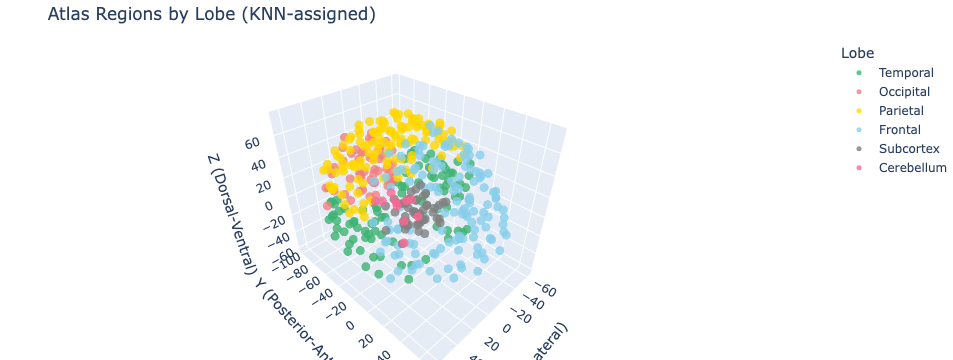

In [8]:
import pandas as pd
import plotly.express as px

# Load updated atlas
df = pd.read_csv("./data/UKBB/atlas-4S456Parcels_dseg_reformatted.csv")

# Fallback hover name if 'parcel_name' is missing
hover_col = "parcel_name" if "parcel_name" in df.columns else "label"
df["hover_label"] = df[hover_col]

# Set unknown lobes to "Unknown"
df["Lobe"] = df["lobe"].fillna("Unknown")

# Count number of regions per lobe
lobe_counts = df["Lobe"].value_counts()
print("\nNumber of regions per lobe:")
for lobe, count in lobe_counts.items():
    print(f"{lobe}: {count}")

# Plot
fig = px.scatter_3d(
    df,
    x="mni_x", y="mni_y", z="mni_z",
    color="Lobe",
    hover_name="hover_label",
    opacity=0.8,
    color_discrete_map={
        "Frontal": "skyblue",
        "Temporal": "mediumseagreen",
        "Parietal": "gold",
        "Occipital": "lightcoral",
        "Subcortex": "gray",
        "Unknown": "black"
    }
)

fig.update_traces(marker=dict(size=5))
fig.update_layout(
    title="Atlas Regions by Lobe (KNN-assigned)",
    scene=dict(
        xaxis_title="X (Lateral)",
        yaxis_title="Y (Posterior-Anterior)",
        zaxis_title="Z (Dorsal-Ventral)"
    ),
    margin=dict(l=0, r=0, b=0, t=40)
)

fig.show()


Number of regions per lobe:
Frontal: 160
Parietal: 107
Temporal: 71
Occipital: 61
Subcortex: 56
Posterior: 1


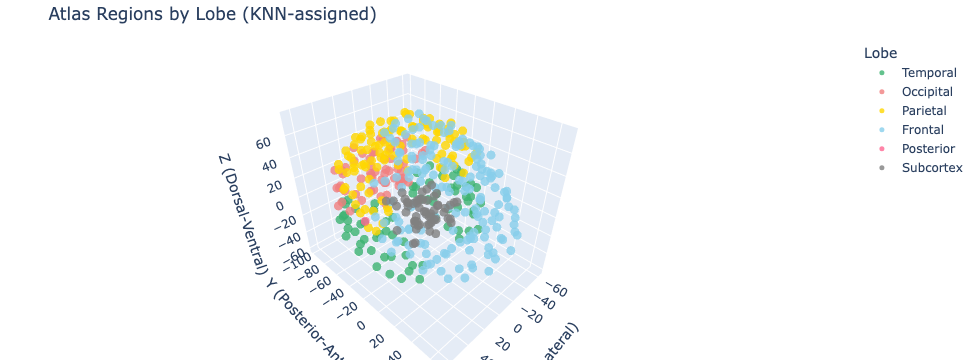

In [10]:
import pandas as pd
import plotly.express as px

# Load updated atlas
df = pd.read_csv("./data/UKBB/atlas_with_lobes_knn.csv")

# Fallback hover name if 'parcel_name' is missing
hover_col = "parcel_name" if "parcel_name" in df.columns else "label"
df["hover_label"] = df[hover_col]

# Set unknown lobes to "Unknown"
df["Lobe"] = df["lobe"].fillna("Unknown")


# Count number of regions per lobe
lobe_counts = df["Lobe"].value_counts()
print("\nNumber of regions per lobe:")
for lobe, count in lobe_counts.items():
    print(f"{lobe}: {count}")

# Plot
fig = px.scatter_3d(
    df,
    x="mni_x", y="mni_y", z="mni_z",
    color="Lobe",
    hover_name="hover_label",
    opacity=0.8,
    color_discrete_map={
        "Frontal": "skyblue",
        "Temporal": "mediumseagreen",
        "Parietal": "gold",
        "Occipital": "lightcoral",
        "Subcortex": "gray",
        "Cerebellum": "black"
    }
)

fig.update_traces(marker=dict(size=5))
fig.update_layout(
    title="Atlas Regions by Lobe (KNN-assigned)",
    scene=dict(
        xaxis_title="X (Lateral)",
        yaxis_title="Y (Posterior-Anterior)",
        zaxis_title="Z (Dorsal-Ventral)"
    ),
    margin=dict(l=0, r=0, b=0, t=40)
)

fig.show()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
Lobe coverage: 100.0% of regions
Lobe sizes: {'Temporal': 91, 'Occipital': 52, 'Parietal': 125, 'Frontal': 132, 'Subcortex': 55}
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset



distutils Version classes are deprecated. Use packaging.version instead.


ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: sn9jzjj5
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/sn9jzjj5
Initialized sweep with ID: sn9jzjj5
Testing network: Temporal
Occipital
Parietal
Frontal
Subcortex


wandb: Agent Starting Run: z2udein7 with config:
wandb: 	aug_prob: 0.2
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 64
wandb: 	deep_hidden_dims: [512, 256, 128]
wandb: 	dropout_rate: 0.2
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 110
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	nhead: 2
wandb: 	num_layers: 2
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 20
wandb: 	transformer_dropout: 0.2
wandb: 	use_alibi: False
wandb: 	weight_decay: 0.001

unclosed <socket.socket fd=72, family=2, type=1, proto=0, laddr=('127.0.0.1', 42022), raddr=('127.0.0.1', 33119)>


ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-sn9jzjj5/config-z2udein7.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please

Processing inner fold 0



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in SMT model: 4038859
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.02 GB



TensorFloat32 tensor cores for float32 matrix multiplication available but not enabled. Consider setting `torch.set_float32_matmul_precision('high')` for better performance.




Best val loss so far at epoch 1: 0.1079
Epoch 5/110, Train Loss: 0.0812, Val Loss: 0.1461, Time: 2.31s
Epoch 10/110, Train Loss: 0.0524, Val Loss: 0.1199, Time: 2.39s
Epoch 15/110, Train Loss: 0.0293, Val Loss: 0.1233, Time: 2.28s
Epoch 20/110, Train Loss: 0.0268, Val Loss: 0.1272, Time: 2.31s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.121820
Epoch 25/110, Train Loss: 0.0139, Val Loss: 0.1138, Time: 2.91s
Best val loss so far at epoch 30: 0.1048
Epoch 30/110, Train Loss: 0.0143, Val Loss: 0.1048, Time: 2.67s
Epoch 35/110, Train Loss: 0.0168, Val Loss: 0.1076, Time: 2.28s
Best val loss so far at epoch 38: 0.1041
Epoch 40/110, Train Loss: 0.0163, Val Loss: 0.1072, Time: 2.20s
Best val loss so far at epoch 42: 0.1006

LR REDUCED: 0.000027 → 0.000008 at Val Loss: 0.102004
Best val loss so far at epoch 45: 0.0995
Epoch 45/110, Train Loss: 0.0149, Val Loss: 0.0995, Time: 2.18s
Best val loss so far at epoch 49: 0.0992
Epoch 50/110, Train Loss: 0.0179, Val Loss: 0.1003, Time: 2.25s
Best v


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
fold0_train_loss,█▅▅▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▆▇█▇▅▆▄▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▂▁▁▂▁▂▁▂▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,109
fold0_train_loss,0.00545
fold0_val_loss,0.08969


wandb: Agent Starting Run: cc5w1mhb with config:
wandb: 	aug_prob: 0.2
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 128
wandb: 	deep_hidden_dims: [512, 256, 128]
wandb: 	dropout_rate: 0.2
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 110
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	nhead: 2
wandb: 	num_layers: 2
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 60
wandb: 	transformer_dropout: 0.2
wandb: 	use_alibi: False
wandb: 	weight_decay: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-sn9jzjj5/config-cc5w1mhb.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignore


unclosed <socket.socket fd=72, family=2, type=1, proto=0, laddr=('127.0.0.1', 46078), raddr=('127.0.0.1', 40489)>




Processing inner fold 0



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in SMT model: 1798795
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.07 GB
Best val loss so far at epoch 1: 0.1675
Best val loss so far at epoch 2: 0.1446
Best val loss so far at epoch 3: 0.1267
Epoch 5/110, Train Loss: 0.0842, Val Loss: 0.1516, Time: 2.25s
Epoch 10/110, Train Loss: 0.0538, Val Loss: 0.1617, Time: 2.31s
Epoch 15/110, Train Loss: 0.0328, Val Loss: 0.1762, Time: 2.30s
Epoch 20/110, Train Loss: 0.0247, Val Loss: 0.1592, Time: 3.23s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.150940
Epoch 25/110, Train Loss: 0.0188, Val Loss: 0.1528, Time: 2.30s
Epoch 30/110, Train Loss: 0.0193, Val Loss: 0.1407, Time: 2.26s
Epoch 35/110, Train Loss: 0.0175, Val Loss: 0.1397, Time: 2.25s
Epoch 40/110, Train Loss: 0.0161, Val Loss: 0.1460, Time: 3.21s
Best val loss so far at epoch 43: 0.1184
Epoch 45/110, Train Loss: 0.0125, Val Loss: 0.1265, Time: 2.20s

LR REDUCED: 0.000027 → 0.000008 at Val Lo


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇▇▇▇████
fold0_train_loss,█▅▅▄▄▂▂▂▂▂▂▂▂▂▁▂▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▆▆▇▇█▇▇▆▅▆▆▃▅▄▄▅▄▂▃▂▂▃▃▂▂▂▂▃▂▂▁▁▁▁▂▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,109
fold0_train_loss,0.00623
fold0_val_loss,0.11651


wandb: Agent Starting Run: ke2vcf15 with config:
wandb: 	aug_prob: 0.4
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 64
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.1
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 70
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	nhead: 4
wandb: 	num_layers: 4
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 20
wandb: 	transformer_dropout: 0.1
wandb: 	use_alibi: True
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-sn9jzjj5/config-ke2vcf15.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored wandb


unclosed <socket.socket fd=83, family=2, type=1, proto=0, laddr=('127.0.0.1', 40138), raddr=('127.0.0.1', 46269)>




Processing inner fold 0



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in SMT model: 2108619
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.07 GB
Best val loss so far at epoch 1: 2.3931
Best val loss so far at epoch 2: 0.2562
Best val loss so far at epoch 3: 0.2198
Best val loss so far at epoch 4: 0.1792
Best val loss so far at epoch 5: 0.1463
Epoch 5/70, Train Loss: 0.0707, Val Loss: 0.1463, Time: 4.64s
Best val loss so far at epoch 6: 0.1114
Best val loss so far at epoch 7: 0.1021
Best val loss so far at epoch 10: 0.0991
Epoch 10/70, Train Loss: 0.0508, Val Loss: 0.0991, Time: 4.57s
Best val loss so far at epoch 12: 0.0948
Best val loss so far at epoch 14: 0.0930
Best val loss so far at epoch 15: 0.0892
Epoch 15/70, Train Loss: 0.0360, Val Loss: 0.0892, Time: 5.00s
Best val loss so far at epoch 17: 0.0871
Best val loss so far at epoch 18: 0.0742
Epoch 20/70, Train Loss: 0.0321, Val Loss: 0.0880, Time: 4.49s
Epoch 25/70, Train Loss: 0.0236, Val Loss: 0.0822, Time:


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇████
fold0_train_loss,█▇▆▆▆▅▅▄▄▄▃▃▃▃▃▂▂▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
fold0_val_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▁▁▁▁▂▁▂▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,62
fold0_train_loss,0.0047
fold0_val_loss,0.21556


wandb: Agent Starting Run: 9lg65ho3 with config:
wandb: 	aug_prob: 0.3
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 64
wandb: 	deep_hidden_dims: [512, 256, 128]
wandb: 	dropout_rate: 0.1
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 70
wandb: 	input_dim: 14760
wandb: 	learning_rate: 0.0001
wandb: 	nhead: 2
wandb: 	num_layers: 4
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 20
wandb: 	transformer_dropout: 0.1
wandb: 	use_alibi: True
wandb: 	weight_decay: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-sn9jzjj5/config-9lg65ho3.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored 


unclosed <socket.socket fd=80, family=2, type=1, proto=0, laddr=('127.0.0.1', 50788), raddr=('127.0.0.1', 40713)>




Processing inner fold 0



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in SMT model: 4130507
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.08 GB
Best val loss so far at epoch 1: 0.2250
Best val loss so far at epoch 2: 0.1707
Best val loss so far at epoch 3: 0.1559
Best val loss so far at epoch 4: 0.1307
Best val loss so far at epoch 5: 0.1280
Epoch 5/70, Train Loss: 0.0668, Val Loss: 0.1280, Time: 3.68s
Best val loss so far at epoch 7: 0.1090
Epoch 10/70, Train Loss: 0.0442, Val Loss: 0.1428, Time: 3.73s
Epoch 15/70, Train Loss: 0.0310, Val Loss: 0.1256, Time: 3.63s
Epoch 20/70, Train Loss: 0.0286, Val Loss: 0.1338, Time: 3.75s
Epoch 25/70, Train Loss: 0.0164, Val Loss: 0.1322, Time: 4.59s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.113957
Epoch 30/70, Train Loss: 0.0153, Val Loss: 0.1178, Time: 3.47s
Epoch 35/70, Train Loss: 0.0122, Val Loss: 0.1197, Time: 3.40s
Epoch 40/70, Train Loss: 0.0131, Val Loss: 0.1182, Time: 3.46s
Epoch 45/70, Train Loss: 0.0114, Va


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
fold0_train_loss,█▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▂▂▃▁▁▃▃▂▂▂▂▂▂▂▂▁▂▁▂▂▁▂▂▁▂▂▂▁▂▂▂▂▂▂▂▂▂▂▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,51
fold0_train_loss,0.00998
fold0_val_loss,0.11785


wandb: Sorting runs by +summary_metrics.mean_val_loss

The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.


Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


BEST CONFIG {'nhead': 2, 'epochs': 110, 'd_model': 64, 'aug_prob': 0.2, 'binarize': False, 'input_dim': 14760, 'use_alibi': False, 'batch_size': 1024, 'num_layers': 2, 'num_workers': 2, 'dropout_rate': 0.2, 'weight_decay': 0.001, 'learning_rate': 9e-05, 'prefetch_factor': 4, 'deep_hidden_dims': [512, 256, 128], 'token_encoder_dim': 20, 'encoder_output_dim': 10, 'transformer_dropout': 0.2}
Number of learnable parameters in SMT model: 4038859



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.



Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.08 GB
Best val loss so far at epoch 1: 0.0515
Best val loss so far at epoch 2: 0.0453
Best val loss so far at epoch 3: 0.0382
Best val loss so far at epoch 4: 0.0338
Best val loss so far at epoch 5: 0.0288
Epoch 5/110, Train Loss: 0.0658, Val Loss: 0.0288, Time: 3.50s
Best val loss so far at epoch 6: 0.0268



unclosed <socket.socket fd=83, family=2, type=1, proto=0, laddr=('127.0.0.1', 36308), raddr=('127.0.0.1', 32965)>



unclosed <socket.socket fd=83, family=2, type=1, proto=0, laddr=('127.0.0.1', 36308), raddr=('127.0.0.1', 32965)>




Best val loss so far at epoch 7: 0.0247
Epoch 45/110, Train Loss: 0.0165, Val Loss: 0.0230, Time: 3.52s



unclosed <socket.socket fd=83, family=2, type=1, proto=0, laddr=('127.0.0.1', 36308), raddr=('127.0.0.1', 32965)>



unclosed <socket.socket fd=83, family=2, type=1, proto=0, laddr=('127.0.0.1', 36308), raddr=('127.0.0.1', 32965)>




Epoch 50/110, Train Loss: 0.0084, Val Loss: 0.0220, Time: 3.25s
Epoch 55/110, Train Loss: 0.0090, Val Loss: 0.0265, Time: 3.16s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.023459
Epoch 60/110, Train Loss: 0.0080, Val Loss: 0.0236, Time: 3.23s
Epoch 65/110, Train Loss: 0.0074, Val Loss: 0.0237, Time: 4.01s
Epoch 70/110, Train Loss: 0.0070, Val Loss: 0.0245, Time: 3.24s
Epoch 75/110, Train Loss: 0.0071, Val Loss: 0.0230, Time: 3.23s
Epoch 80/110, Train Loss: 0.0064, Val Loss: 0.0236, Time: 3.42s

LR REDUCED: 0.000027 → 0.000008 at Val Loss: 0.024558

Early stopping triggered at epoch 83. Restoring best model with Val Loss: 0.0194, Pearson Correlation: 0.6599
Running train evaluation...

=== TRAIN EVALUATION ===
Evaluating 364 regions, 132132 connections


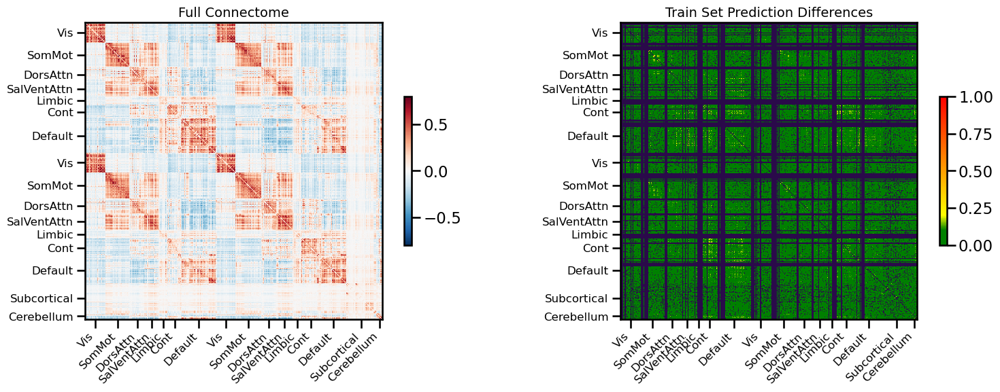

<Figure size 640x480 with 0 Axes>

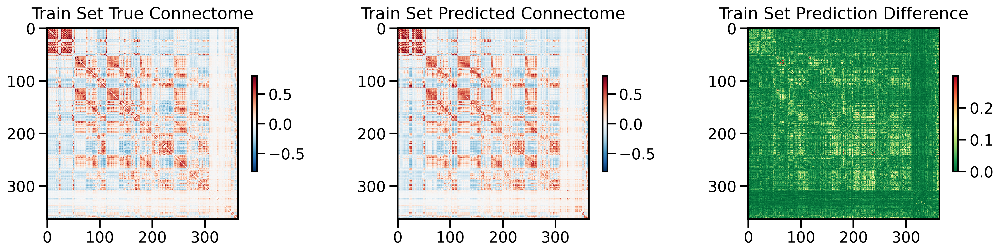


unclosed <socket.socket fd=83, family=2, type=1, proto=0, laddr=('127.0.0.1', 36308), raddr=('127.0.0.1', 32965)>




<Figure size 640x480 with 0 Axes>

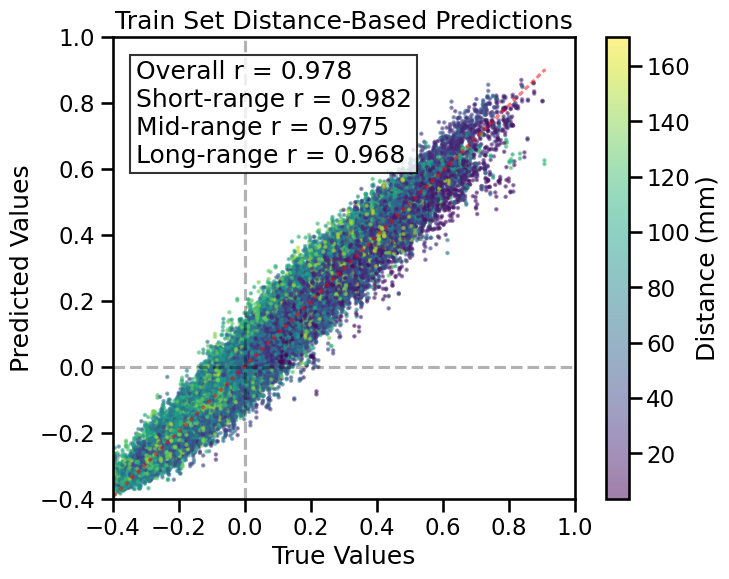

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 91 regions, 8190 connections


<Figure size 640x480 with 0 Axes>

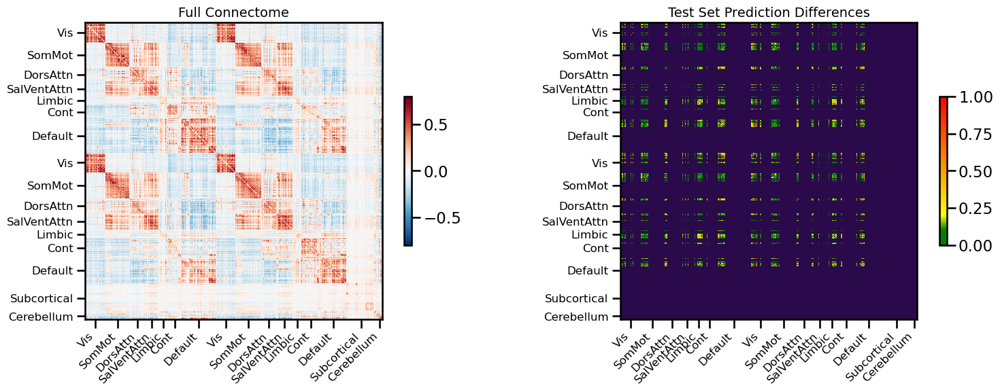

<Figure size 640x480 with 0 Axes>

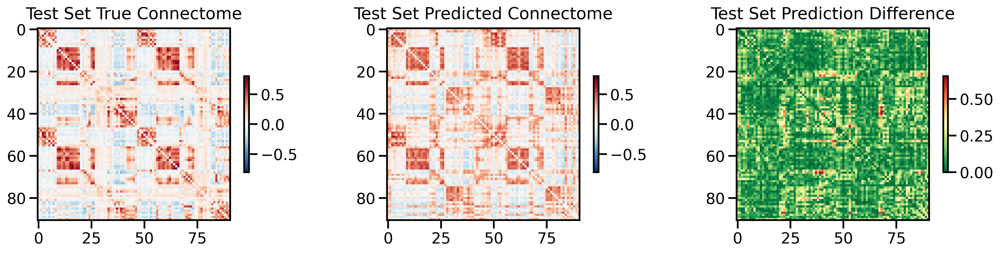

<Figure size 640x480 with 0 Axes>

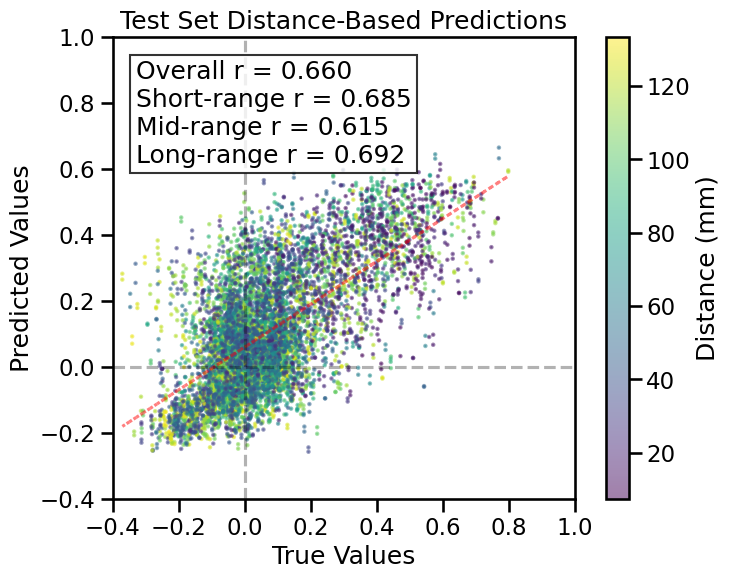

TRAIN METRICS
GLOBAL: mse=0.001579, mae=0.028374, r2=0.9562, pearson_r=0.9784, spearman_r=0.9752, geodesic_distance=14.2010
DISTANCE-BASED: short=0.9815, mid=0.9746, long=0.9685
HEMISPHERIC: left=0.9796, right=0.9855, inter=0.9805
CONNECTION STRENGTH: neg=0.6749, weak=0.9621, pos=0.8552
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9789    0.9819
  Default       0.9857    0.9840
  SalVentAttn    0.9813    0.9822
  Limbic        0.9868    0.9803
  DorsAttn      0.9809    0.9845
  SomMot        0.9835    0.9864
  Vis           0.9933    0.9884
  Subcortical    0.9793    0.9815
  Cerebellum    0.9876    0.9786

TEST METRICS
GLOBAL: mse=0.024275, mae=0.117461, r2=0.2983, pearson_r=0.6599, spearman_r=0.5832, geodesic_distance=9.0686
DISTANCE-BASED: short=0.6852, mid=0.6152, long=0.6923
HEMISPHERIC: left=0.6876, right=0.6453, inter=0.6573
CONNECTION STRENGTH: weak=0.4624, pos=0.3323
NETWORK CORRELATIONS:
  NETWORK      INTRA      INT


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




best_val_loss,▁
test_mse_loss,█▄▃▂▂▂▂▂▂▁▁▁▂▂▂▁▁▂▁▁▁▁▂▂▁▂▂▂▁▂▂▂▂▂▁▂▂▂▂▂
train_mse_loss,█▇▆▅▄▂▂▂▂▂▂▂▂▂▁▁▂▁▁▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0.08969
test_mse_loss,0.02428
train_mse_loss,0.00533


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: n0b21gv8
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/n0b21gv8
Initialized sweep with ID: n0b21gv8
Testing network: Occipital
Temporal
Parietal
Frontal
Subcortex


wandb: Agent Starting Run: d2cqohxp with config:
wandb: 	aug_prob: 0.5
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 128
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.1
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 110
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	nhead: 2
wandb: 	num_layers: 2
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 60
wandb: 	transformer_dropout: 0.1
wandb: 	use_alibi: True
wandb: 	weight_decay: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-n0b21gv8/config-d2cqohxp.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored wand

Processing inner fold 0



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in SMT model: 1036427
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.13 GB
Best val loss so far at epoch 1: 0.0394
Best val loss so far at epoch 2: 0.0378
Best val loss so far at epoch 3: 0.0334
Best val loss so far at epoch 4: 0.0331
Best val loss so far at epoch 5: 0.0297
Epoch 5/110, Train Loss: 0.0801, Val Loss: 0.0297, Time: 2.42s
Best val loss so far at epoch 6: 0.0290
Best val loss so far at epoch 7: 0.0284
Best val loss so far at epoch 8: 0.0274
Best val loss so far at epoch 9: 0.0273
Best val loss so far at epoch 10: 0.0261
Epoch 10/110, Train Loss: 0.0575, Val Loss: 0.0261, Time: 4.28s
Best val loss so far at epoch 11: 0.0260
Epoch 15/110, Train Loss: 0.0441, Val Loss: 0.0302, Time: 2.42s
Epoch 20/110, Train Loss: 0.0343, Val Loss: 0.0282, Time: 2.41s
Epoch 25/110, Train Loss: 0.0370, Val Loss: 0.0264, Time: 2.46s
Epoch 30/110, Train Loss: 0.0283, Val Loss: 0.0282, Time: 2.43s

LR REDU


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇██
fold0_train_loss,█▅▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▂▁▁▁▂▁▁▁▁▁▁▁▁
fold0_val_loss,▆▃▃▁▄▄█▇▂▂▁▄▁▂▄▅▁▁▂▂▂▂▃▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,89
fold0_train_loss,0.00946
fold0_val_loss,0.02674


wandb: Agent Starting Run: u5nz41y0 with config:
wandb: 	aug_prob: 0.4
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 128
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.2
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 110
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	nhead: 4
wandb: 	num_layers: 4
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 60
wandb: 	transformer_dropout: 0.1
wandb: 	use_alibi: True
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-n0b21gv8/config-u5nz41y0.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored wan

Processing inner fold 0



unclosed <socket.socket fd=112, family=2, type=1, proto=0, laddr=('127.0.0.1', 35974), raddr=('127.0.0.1', 36685)>



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in SMT model: 1399947
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.16 GB
Best val loss so far at epoch 1: 0.0491
Best val loss so far at epoch 2: 0.0362
Best val loss so far at epoch 3: 0.0356
Best val loss so far at epoch 4: 0.0353
Best val loss so far at epoch 5: 0.0305
Epoch 5/110, Train Loss: 0.0914, Val Loss: 0.0305, Time: 2.95s
Best val loss so far at epoch 7: 0.0287
Best val loss so far at epoch 8: 0.0270
Best val loss so far at epoch 9: 0.0260
Epoch 10/110, Train Loss: 0.0587, Val Loss: 0.0265, Time: 4.60s
Best val loss so far at epoch 13: 0.0260
Best val loss so far at epoch 15: 0.0252
Epoch 15/110, Train Loss: 0.0406, Val Loss: 0.0252, Time: 2.94s
Best val loss so far at epoch 16: 0.0252
Best val loss so far at epoch 18: 0.0246
Epoch 20/110, Train Loss: 0.0350, Val Loss: 0.0257, Time: 4.58s
Epoch 25/110, Train Loss: 0.0254, Val Loss: 0.0249, Time: 2.76s

LR REDUCED: 0.000090 → 0.0000


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███
fold0_train_loss,█▆▄▄▃▂▃▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▂▄▅▃▂▄▃▂▂▁▁▂▃▂▃▁▁▁▁▁▂▁▁▁▁▁▂▁▁▁▂▂▂▂▂▁▂▁▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,84
fold0_train_loss,0.00699
fold0_val_loss,0.02475


wandb: Agent Starting Run: hdvly4yn with config:
wandb: 	aug_prob: 0.3
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 128
wandb: 	deep_hidden_dims: [512, 256, 128]
wandb: 	dropout_rate: 0.2
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 70
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	nhead: 4
wandb: 	num_layers: 2
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 20
wandb: 	transformer_dropout: 0.2
wandb: 	use_alibi: True
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-n0b21gv8/config-hdvly4yn.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored

Processing inner fold 0



unclosed <socket.socket fd=112, family=2, type=1, proto=0, laddr=('127.0.0.1', 34438), raddr=('127.0.0.1', 39191)>



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in SMT model: 4312715
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.17 GB
Best val loss so far at epoch 1: 0.0355
Best val loss so far at epoch 3: 0.0353
Best val loss so far at epoch 4: 0.0345
Best val loss so far at epoch 5: 0.0301
Epoch 5/70, Train Loss: 0.0831, Val Loss: 0.0301, Time: 3.64s
Best val loss so far at epoch 6: 0.0283
Best val loss so far at epoch 7: 0.0278
Best val loss so far at epoch 8: 0.0265
Epoch 10/70, Train Loss: 0.0537, Val Loss: 0.0266, Time: 3.82s
Best val loss so far at epoch 11: 0.0264
Epoch 15/70, Train Loss: 0.0343, Val Loss: 0.0343, Time: 3.64s
Epoch 20/70, Train Loss: 0.0237, Val Loss: 0.0288, Time: 3.52s
Epoch 25/70, Train Loss: 0.0230, Val Loss: 0.0306, Time: 3.58s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.025719
Best val loss so far at epoch 29: 0.0257
Epoch 30/70, Train Loss: 0.0168, Val Loss: 0.0268, Time: 3.44s
Epoch 35/70, Train Loss: 0.0204, Val Lo


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇████
fold0_train_loss,█▇▆▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▇▄▃▂▂▂▃▂▆▃█▄▃▄▅▂▄▁▂▃▂▂▂▁▂▁▂▁▂▃▂▂▂▂▂▂▂▂▂▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,69
fold0_train_loss,0.00495
fold0_val_loss,0.0269


wandb: Sorting runs by +summary_metrics.mean_val_loss

The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.


Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


BEST CONFIG {'nhead': 2, 'epochs': 110, 'd_model': 64, 'aug_prob': 0.1, 'binarize': False, 'input_dim': 14760, 'use_alibi': True, 'batch_size': 1024, 'num_layers': 2, 'num_workers': 2, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'learning_rate': 9e-05, 'prefetch_factor': 4, 'deep_hidden_dims': [512, 256, 128], 'token_encoder_dim': 20, 'encoder_output_dim': 10, 'transformer_dropout': 0.1}
Number of learnable parameters in SMT model: 4038859



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.



Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.17 GB
Best val loss so far at epoch 1: 0.1121
Epoch 5/110, Train Loss: 0.0445, Val Loss: 0.1162, Time: 3.88s
Best val loss so far at epoch 6: 0.1051



unclosed <socket.socket fd=80, family=2, type=1, proto=0, laddr=('127.0.0.1', 59852), raddr=('127.0.0.1', 38493)>



unclosed <socket.socket fd=114, family=2, type=1, proto=0, laddr=('127.0.0.1', 34396), raddr=('127.0.0.1', 36377)>



unclosed <socket.socket fd=80, family=2, type=1, proto=0, laddr=('127.0.0.1', 59852), raddr=('127.0.0.1', 38493)>



unclosed <socket.socket fd=114, family=2, type=1, proto=0, laddr=('127.0.0.1', 34396), raddr=('127.0.0.1', 36377)>




Best val loss so far at epoch 8: 0.0970
Best val loss so far at epoch 9: 0.0833
Epoch 10/110, Train Loss: 0.0215, Val Loss: 0.0892, Time: 3.72s
Best val loss so far at epoch 11: 0.0774
Best val loss so far at epoch 12: 0.0770
Best val loss so far at epoch 13: 0.0667
Epoch 15/110, Train Loss: 0.0179, Val Loss: 0.0701, Time: 3.76s
Best val loss so far at epoch 20: 0.0655
Epoch 20/110, Train Loss: 0.0097, Val Loss: 0.0655, Time: 3.76s
Epoch 25/110, Train Loss: 0.0109, Val Loss: 0.0683, Time: 3.79s
Best val loss so far at epoch 26: 0.0514
Epoch 30/110, Train Loss: 0.0090, Val Loss: 0.0596, Time: 3.63s
Epoch 35/110, Train Loss: 0.0080, Val Loss: 0.0539, Time: 5.99s
Epoch 40/110, Train Loss: 0.0052, Val Loss: 0.0521, Time: 3.71s
Best val loss so far at epoch 43: 0.0440
Epoch 45/110, Train Loss: 0.0078, Val Loss: 0.0454, Time: 3.68s
Best val loss so far at epoch 48: 0.0419
Epoch 50/110, Train Loss: 0.0063, Val Loss: 0.0452, Time: 3.91s
Epoch 55/110, Train Loss: 0.0053, Val Loss: 0.0449, Time:

<Figure size 640x480 with 0 Axes>

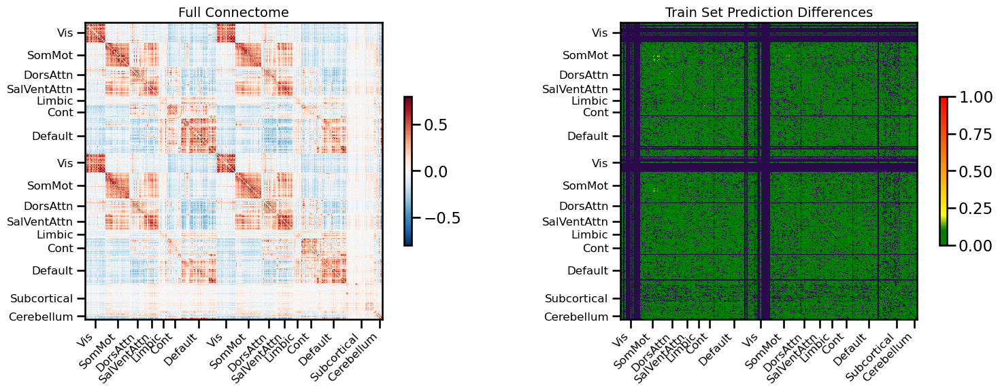

<Figure size 640x480 with 0 Axes>

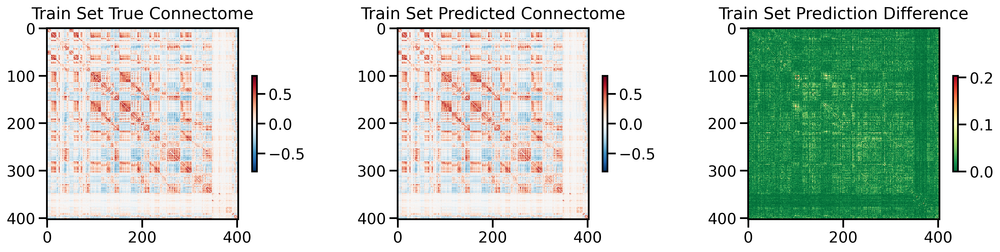


unclosed <socket.socket fd=80, family=2, type=1, proto=0, laddr=('127.0.0.1', 59852), raddr=('127.0.0.1', 38493)>



unclosed <socket.socket fd=114, family=2, type=1, proto=0, laddr=('127.0.0.1', 34396), raddr=('127.0.0.1', 36377)>




<Figure size 640x480 with 0 Axes>

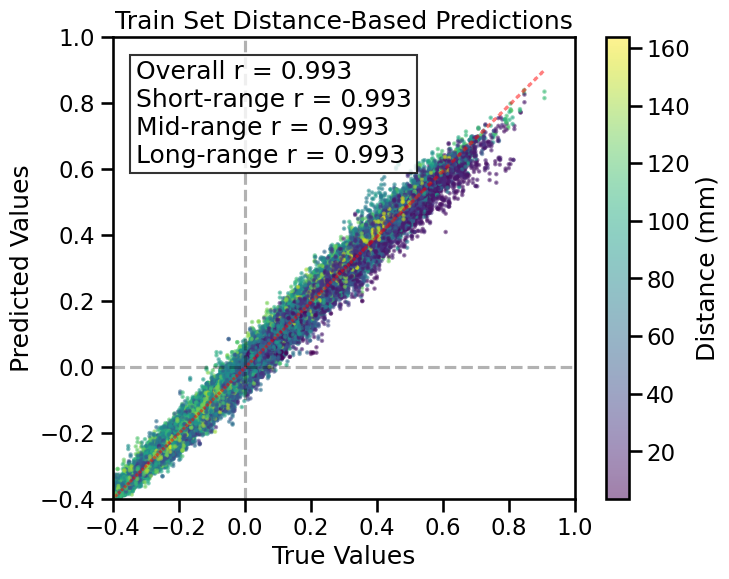

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 52 regions, 2652 connections


<Figure size 640x480 with 0 Axes>

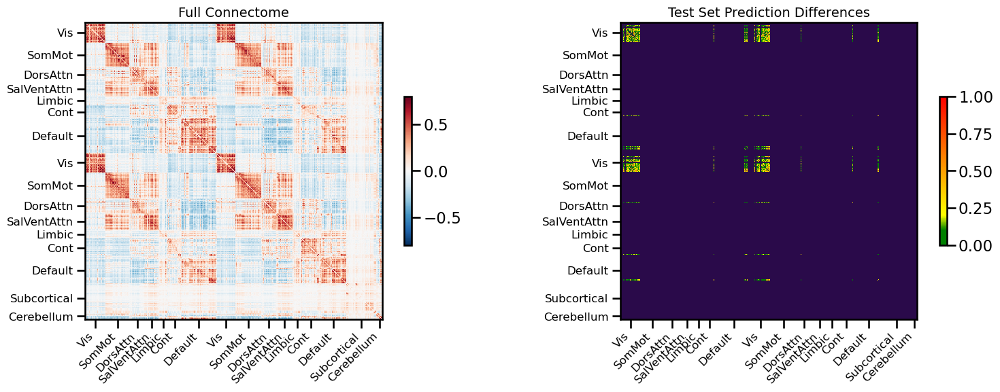

<Figure size 640x480 with 0 Axes>

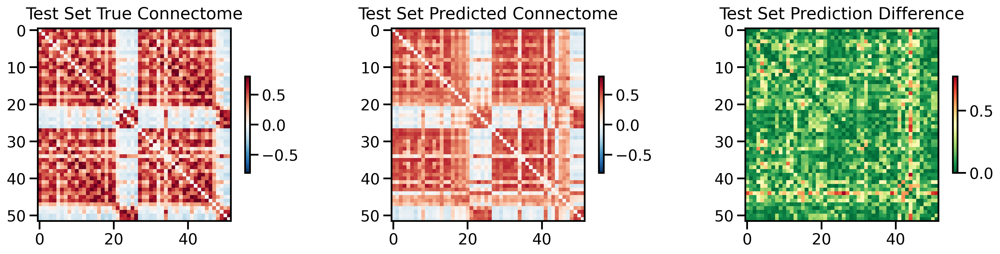

<Figure size 640x480 with 0 Axes>

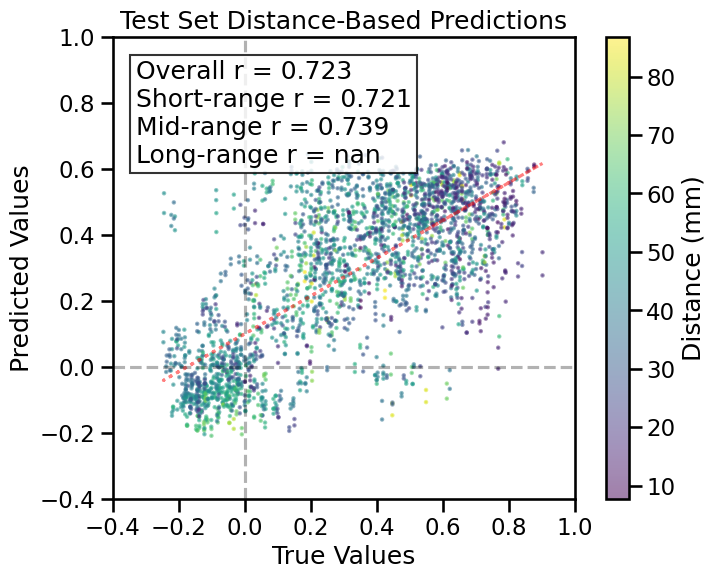

TRAIN METRICS
GLOBAL: mse=0.000463, mae=0.015732, r2=0.9858, pearson_r=0.9930, spearman_r=0.9909, geodesic_distance=13.8665
DISTANCE-BASED: short=0.9932, mid=0.9928, long=0.9931
HEMISPHERIC: left=0.9930, right=0.9948, inter=0.9937
CONNECTION STRENGTH: neg=0.8613, weak=0.9882, pos=0.9407
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9947    0.9942
  Default       0.9947    0.9938
  SalVentAttn    0.9962    0.9945
  Limbic        0.9959    0.9954
  DorsAttn      0.9921    0.9927
  SomMot        0.9899    0.9925
  Vis           0.9891    0.9933
  Subcortical    0.9922    0.9934
  Cerebellum    0.9200    0.9926

TEST METRICS
GLOBAL: mse=0.043037, mae=0.158475, r2=0.5066, pearson_r=0.7232, spearman_r=0.6799, geodesic_distance=5.5198
DISTANCE-BASED: short=0.7213, mid=0.7393
HEMISPHERIC: left=0.7787, right=0.6723, inter=0.7248
CONNECTION STRENGTH: weak=0.6555, pos=0.2031
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  --------


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




best_val_loss,▁
test_mse_loss,█▇▅▄▃▄▃▃▂▃▂▂▄▄▂▁▁▂▂▁▁▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▇▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0.02475
test_mse_loss,0.04399
train_mse_loss,0.0013


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: widmxgei
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/widmxgei
Initialized sweep with ID: widmxgei
Testing network: Parietal
Temporal
Occipital
Frontal
Subcortex


wandb: Agent Starting Run: vd7ylrnr with config:
wandb: 	aug_prob: 0.1
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 64
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.1
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 90
wandb: 	input_dim: 14760
wandb: 	learning_rate: 0.0001
wandb: 	nhead: 2
wandb: 	num_layers: 2
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 60
wandb: 	transformer_dropout: 0.1
wandb: 	use_alibi: True
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-widmxgei/config-vd7ylrnr.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored wand


The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Processing inner fold 0
Number of learnable parameters in SMT model: 760011
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.16 GB
Best val loss so far at epoch 1: 0.0391
Best val loss so far at epoch 2: 0.0390
Best val loss so far at epoch 3: 0.0375
Best val loss so far at epoch 4: 0.0363
Epoch 5/90, Train Loss: 0.0615, Val Loss: 0.0375, Time: 1.45s
Best val loss so far at epoch 8: 0.0355
Best val loss so far at epoch 10: 0.0350
Epoch 10/90, Train Loss: 0.0456, Val Loss: 0.0350, Time: 1.46s
Best val loss so far at epoch 11: 0.0332
Best val loss so far at epoch 13: 0.0316
Best val loss so far at epoch 15: 0.0309
Epoch 15/90, Train Loss: 0.0342, Val Loss: 0.0309, Time: 1.48s
Best val loss so far at epoch 20: 0.0309
Epoch 20/90, Train Loss: 0.0261, Val Loss: 0.0309, Time: 2.74s
Epoch 25/90, Train Loss: 0.0163, Val Loss: 0.0323, Time: 1.47s
Epoch 30/90, Train Loss: 0.0148, Val Loss: 0.0331, Time: 1.46s
Epoch 35/90, Train Loss: 0.0


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▁▁▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇████
fold0_train_loss,█▅▄▄▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,██▇▆▇▅▅▅▃▄▂▃▂▁▁▂▂▂▂▃▄▂▃▄▃▃▃▃▂▂▂▃▃▃▃▃▃▃▃▃
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,64
fold0_train_loss,0.00632
fold0_val_loss,0.03299


wandb: Agent Starting Run: 1x65pe0y with config:
wandb: 	aug_prob: 0.3
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 64
wandb: 	deep_hidden_dims: [512, 256, 128]
wandb: 	dropout_rate: 0.2
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 90
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	nhead: 2
wandb: 	num_layers: 4
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 60
wandb: 	transformer_dropout: 0.1
wandb: 	use_alibi: True
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-widmxgei/config-1x65pe0y.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored 


unclosed <socket.socket fd=112, family=2, type=1, proto=0, laddr=('127.0.0.1', 37158), raddr=('127.0.0.1', 35057)>



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Processing inner fold 0
Number of learnable parameters in SMT model: 1614027
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.16 GB
Best val loss so far at epoch 1: 0.0354
Epoch 5/90, Train Loss: 0.1025, Val Loss: 0.0397, Time: 1.53s
Epoch 10/90, Train Loss: 0.0662, Val Loss: 0.0378, Time: 1.48s
Epoch 15/90, Train Loss: 0.0525, Val Loss: 0.0368, Time: 1.55s
Best val loss so far at epoch 19: 0.0352
Epoch 20/90, Train Loss: 0.0397, Val Loss: 0.0355, Time: 1.55s
Best val loss so far at epoch 21: 0.0346

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.034003
Best val loss so far at epoch 22: 0.0340
Best val loss so far at epoch 23: 0.0339
Best val loss so far at epoch 24: 0.0336
Best val loss so far at epoch 25: 0.0331
Epoch 25/90, Train Loss: 0.0403, Val Loss: 0.0331, Time: 1.54s
Best val loss so far at epoch 26: 0.0322
Best val loss so far at epoch 28: 0.0320
Epoch 30/90, Train Loss: 0.0336, Val Loss: 0.0323, Time: 1.58s
Best val 


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇█
fold0_train_loss,█▆▅▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,86
fold0_train_loss,0.01096
fold0_val_loss,0.03249


wandb: Agent Starting Run: gh1bg8g0 with config:
wandb: 	aug_prob: 0.5
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 128
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.1
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 70
wandb: 	input_dim: 14760
wandb: 	learning_rate: 0.0001
wandb: 	nhead: 2
wandb: 	num_layers: 2
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 60
wandb: 	transformer_dropout: 0.1
wandb: 	use_alibi: True
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-widmxgei/config-gh1bg8g0.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored wan


unclosed <socket.socket fd=114, family=2, type=1, proto=0, laddr=('127.0.0.1', 40862), raddr=('127.0.0.1', 33997)>



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Processing inner fold 0
Number of learnable parameters in SMT model: 1036427
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.16 GB
Best val loss so far at epoch 1: 0.0398
Best val loss so far at epoch 2: 0.0380
Best val loss so far at epoch 3: 0.0372
Best val loss so far at epoch 4: 0.0370
Epoch 5/70, Train Loss: 0.0814, Val Loss: 0.0377, Time: 1.73s
Best val loss so far at epoch 6: 0.0368
Best val loss so far at epoch 7: 0.0345
Epoch 10/70, Train Loss: 0.0686, Val Loss: 0.0360, Time: 1.69s
Best val loss so far at epoch 12: 0.0330
Best val loss so far at epoch 14: 0.0310
Epoch 15/70, Train Loss: 0.0526, Val Loss: 0.0328, Time: 1.61s
Epoch 20/70, Train Loss: 0.0462, Val Loss: 0.0314, Time: 1.68s
Epoch 25/70, Train Loss: 0.0393, Val Loss: 0.0344, Time: 1.63s
Epoch 30/70, Train Loss: 0.0282, Val Loss: 0.0312, Time: 1.63s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.032326
Epoch 35/70, Train Loss: 0.0302, Val Loss: 0.0323, Time


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
fold0_train_loss,█▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▆▆▆▆▅▅▄▃▃▂▁▂▃▃▄▄▂▃▃▁▃▂▂▄▂▂▂▂▃▃▃▁▁▂▂▂▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,69
fold0_train_loss,0.00764
fold0_val_loss,0.03121


wandb: Agent Starting Run: sqi81qge with config:
wandb: 	aug_prob: 0.5
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 128
wandb: 	deep_hidden_dims: [512, 256, 128]
wandb: 	dropout_rate: 0.1
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 90
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	nhead: 4
wandb: 	num_layers: 2
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 20
wandb: 	transformer_dropout: 0.2
wandb: 	use_alibi: True
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-widmxgei/config-sqi81qge.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored

Processing inner fold 0



unclosed <socket.socket fd=112, family=2, type=1, proto=0, laddr=('127.0.0.1', 36772), raddr=('127.0.0.1', 44795)>



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in SMT model: 4312715
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.17 GB
Best val loss so far at epoch 1: 0.0456
Best val loss so far at epoch 2: 0.0374
Best val loss so far at epoch 3: 0.0354
Best val loss so far at epoch 4: 0.0350
Best val loss so far at epoch 5: 0.0336
Epoch 5/90, Train Loss: 0.0914, Val Loss: 0.0336, Time: 2.61s
Best val loss so far at epoch 9: 0.0331
Best val loss so far at epoch 10: 0.0330
Epoch 10/90, Train Loss: 0.0727, Val Loss: 0.0330, Time: 2.55s
Best val loss so far at epoch 11: 0.0328
Best val loss so far at epoch 12: 0.0321
Best val loss so far at epoch 14: 0.0301
Epoch 15/90, Train Loss: 0.0598, Val Loss: 0.0328, Time: 2.52s
Epoch 20/90, Train Loss: 0.0430, Val Loss: 0.0314, Time: 2.43s
Epoch 25/90, Train Loss: 0.0335, Val Loss: 0.0303, Time: 2.35s
Best val loss so far at epoch 27: 0.0300
Epoch 30/90, Train Loss: 0.0370, Val Loss: 0.0325, Time: 2.46s

LR REDUCED


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇████
fold0_train_loss,█▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▄▃▃▃▂▂▂▂▂▂▁▂▂▁▂▂▂▂▂▃▂▂▃▃▃▂▃▂▁▃▂▂▂▂▂▂▂▃▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,71
fold0_train_loss,0.0082
fold0_val_loss,0.03313


wandb: Sorting runs by +summary_metrics.mean_val_loss

The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.


Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


BEST CONFIG {'nhead': 2, 'epochs': 70, 'd_model': 128, 'aug_prob': 0.5, 'binarize': False, 'input_dim': 14760, 'use_alibi': True, 'batch_size': 1024, 'num_layers': 2, 'num_workers': 2, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'learning_rate': 0.0001, 'prefetch_factor': 4, 'deep_hidden_dims': [256, 128], 'token_encoder_dim': 60, 'encoder_output_dim': 10, 'transformer_dropout': 0.1}
Number of learnable parameters in SMT model: 1036427



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.



Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.16 GB
Best val loss so far at epoch 1: 0.0711
Best val loss so far at epoch 2: 0.0695
Best val loss so far at epoch 3: 0.0674
Best val loss so far at epoch 4: 0.0636
Epoch 5/70, Train Loss: 0.0689, Val Loss: 0.0660, Time: 3.31s
Best val loss so far at epoch 6: 0.0628
Best val loss so far at epoch 7: 0.0553
Best val loss so far at epoch 9: 0.0488
Best val loss so far at epoch 10: 0.0464
Epoch 10/70, Train Loss: 0.0504, Val Loss: 0.0464, Time: 3.28s
Best val loss so far at epoch 11: 0.0423



unclosed <socket.socket fd=72, family=2, type=1, proto=0, laddr=('127.0.0.1', 52064), raddr=('127.0.0.1', 43909)>



unclosed <socket.socket fd=72, family=2, type=1, proto=0, laddr=('127.0.0.1', 52064), raddr=('127.0.0.1', 43909)>



unclosed <socket.socket fd=114, family=2, type=1, proto=0, laddr=('127.0.0.1', 50998), raddr=('127.0.0.1', 35243)>



unclosed <socket.socket fd=114, family=2, type=1, proto=0, laddr=('127.0.0.1', 50998), raddr=('127.0.0.1', 35243)>




Epoch 15/70, Train Loss: 0.0418, Val Loss: 0.0448, Time: 3.35s
Best val loss so far at epoch 18: 0.0406
Epoch 20/70, Train Loss: 0.0312, Val Loss: 0.0438, Time: 3.12s
Best val loss so far at epoch 24: 0.0399
Epoch 25/70, Train Loss: 0.0284, Val Loss: 0.0422, Time: 3.24s
Best val loss so far at epoch 27: 0.0377
Best val loss so far at epoch 30: 0.0369
Epoch 30/70, Train Loss: 0.0216, Val Loss: 0.0369, Time: 3.01s
Epoch 35/70, Train Loss: 0.0220, Val Loss: 0.0373, Time: 2.87s
Epoch 40/70, Train Loss: 0.0181, Val Loss: 0.0370, Time: 2.87s
Best val loss so far at epoch 41: 0.0366
Best val loss so far at epoch 42: 0.0351
Best val loss so far at epoch 45: 0.0345
Epoch 45/70, Train Loss: 0.0139, Val Loss: 0.0345, Time: 2.86s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.035211
Epoch 50/70, Train Loss: 0.0119, Val Loss: 0.0345, Time: 2.86s
Best val loss so far at epoch 54: 0.0340



unclosed <socket.socket fd=72, family=2, type=1, proto=0, laddr=('127.0.0.1', 52064), raddr=('127.0.0.1', 43909)>



unclosed <socket.socket fd=114, family=2, type=1, proto=0, laddr=('127.0.0.1', 50998), raddr=('127.0.0.1', 35243)>




Best val loss so far at epoch 55: 0.0337
Epoch 55/70, Train Loss: 0.0092, Val Loss: 0.0337, Time: 4.51s
Epoch 60/70, Train Loss: 0.0078, Val Loss: 0.0344, Time: 2.80s



unclosed <socket.socket fd=72, family=2, type=1, proto=0, laddr=('127.0.0.1', 52064), raddr=('127.0.0.1', 43909)>



unclosed <socket.socket fd=114, family=2, type=1, proto=0, laddr=('127.0.0.1', 50998), raddr=('127.0.0.1', 35243)>




Epoch 65/70, Train Loss: 0.0061, Val Loss: 0.0354, Time: 2.77s

Reached final epoch 70. Restoring best model with Val Loss: 0.0337, Pearson Correlation: 0.7088
Running train evaluation...

=== TRAIN EVALUATION ===
Evaluating 330 regions, 108570 connections


<Figure size 640x480 with 0 Axes>

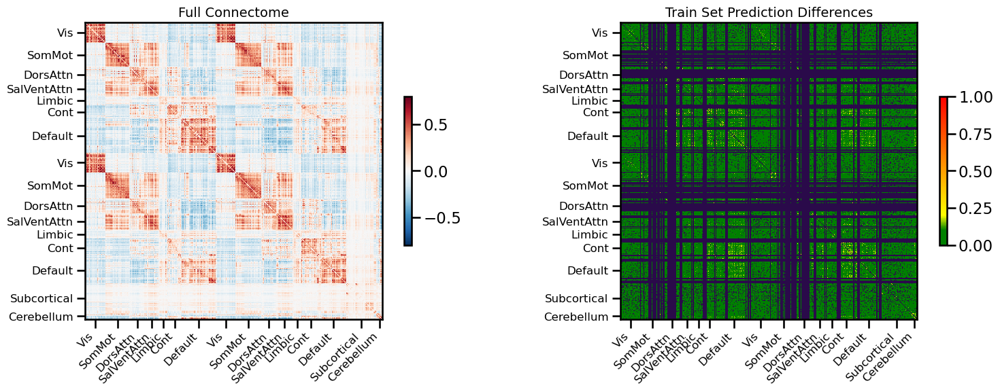

<Figure size 640x480 with 0 Axes>

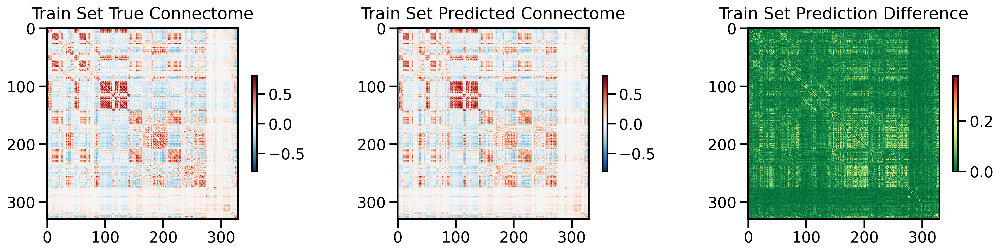


unclosed <socket.socket fd=72, family=2, type=1, proto=0, laddr=('127.0.0.1', 52064), raddr=('127.0.0.1', 43909)>



unclosed <socket.socket fd=114, family=2, type=1, proto=0, laddr=('127.0.0.1', 50998), raddr=('127.0.0.1', 35243)>




<Figure size 640x480 with 0 Axes>

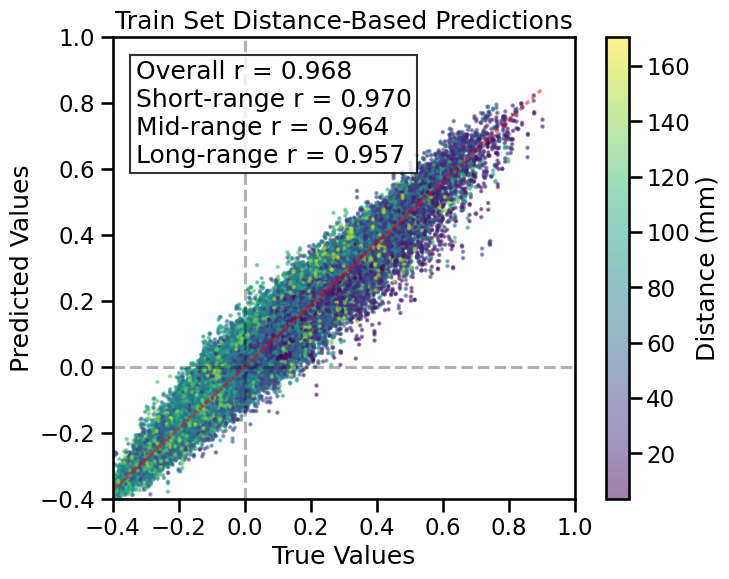

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 125 regions, 15500 connections


<Figure size 640x480 with 0 Axes>

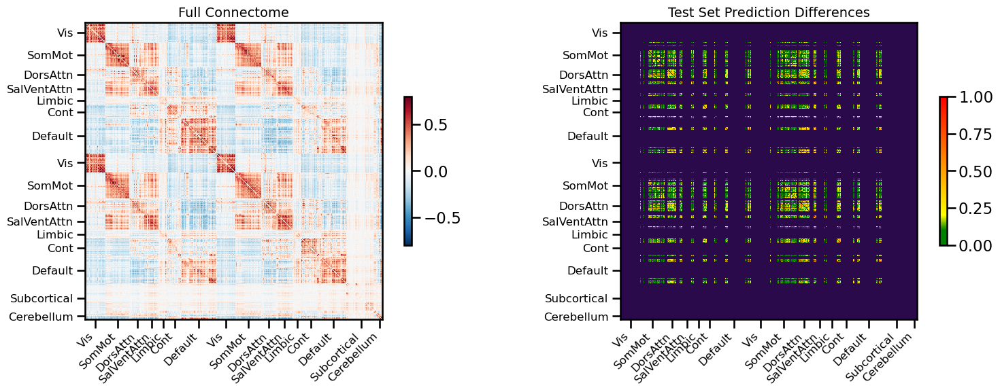

<Figure size 640x480 with 0 Axes>

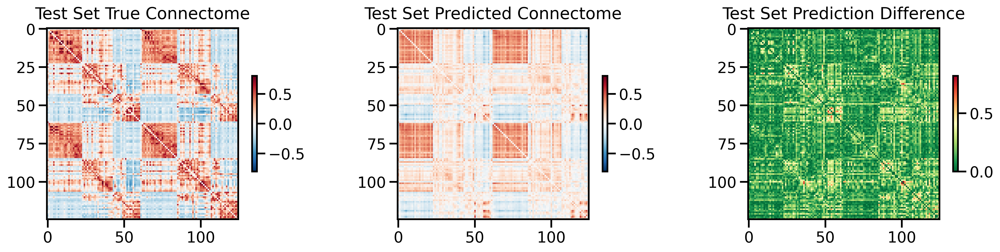

<Figure size 640x480 with 0 Axes>

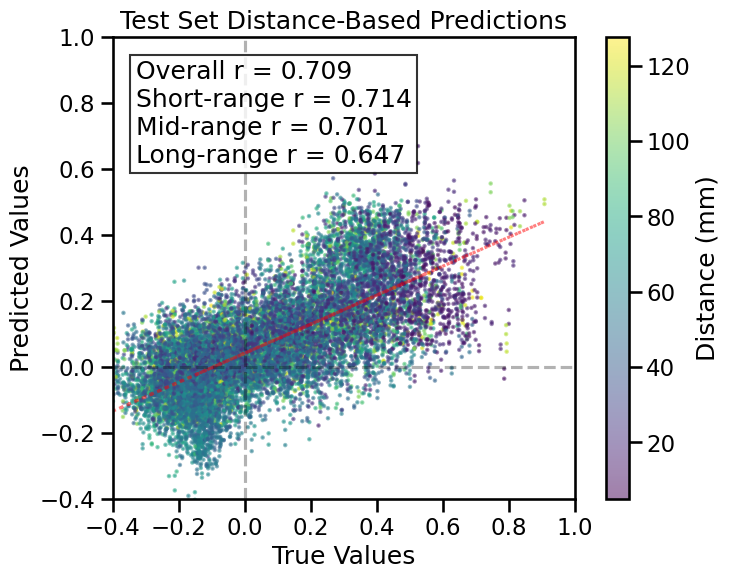

TRAIN METRICS
GLOBAL: mse=0.001903, mae=0.030375, r2=0.9376, pearson_r=0.9683, spearman_r=0.9591, geodesic_distance=16.5839
DISTANCE-BASED: short=0.9698, mid=0.9644, long=0.9571
HEMISPHERIC: left=0.9710, right=0.9749, inter=0.9706
CONNECTION STRENGTH: neg=0.6466, weak=0.9464, pos=0.8284
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9509    0.9672
  Default       0.9655    0.9716
  SalVentAttn    0.9723    0.9700
  Limbic        0.9794    0.9706
  DorsAttn      0.9809    0.9710
  SomMot        0.9801    0.9692
  Vis           0.9700    0.9757
  Subcortical    0.9915    0.9688
  Cerebellum    0.8040    0.9699

TEST METRICS
GLOBAL: mse=0.032021, mae=0.140292, r2=0.4943, pearson_r=0.7088, spearman_r=0.7134, geodesic_distance=13.7386
DISTANCE-BASED: short=0.7137, mid=0.7009, long=0.6474
HEMISPHERIC: left=0.6858, right=0.6953, inter=0.7227
CONNECTION STRENGTH: neg=-0.1946, weak=0.5951, pos=0.0912
NETWORK CORRELATIONS:
  NETWORK      


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




best_val_loss,▁
test_mse_loss,██▇▆▅▃▃▃▃▃▃▂▃▂▃▂▂▂▂▃▂▂▃▂▃▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▇▇▆▆▆▅▄▅▄▄▃▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁
best_val_loss,0.03121
test_mse_loss,0.03472
train_mse_loss,0.00326


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 5ge4wlgt
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/5ge4wlgt
Initialized sweep with ID: 5ge4wlgt
Testing network: Frontal
Temporal
Occipital
Parietal
Subcortex


wandb: Agent Starting Run: ze3opkfg with config:
wandb: 	aug_prob: 0.1
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 64
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.2
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 90
wandb: 	input_dim: 14760
wandb: 	learning_rate: 0.0001
wandb: 	nhead: 4
wandb: 	num_layers: 4
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 20
wandb: 	transformer_dropout: 0.2
wandb: 	use_alibi: True
wandb: 	weight_decay: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-5ge4wlgt/config-ze3opkfg.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored wandb

Processing inner fold 0



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in SMT model: 2108619
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.12 GB
Best val loss so far at epoch 1: 0.2239
Best val loss so far at epoch 2: 0.1828
Best val loss so far at epoch 3: 0.1352
Best val loss so far at epoch 4: 0.0837
Best val loss so far at epoch 5: 0.0776
Epoch 5/90, Train Loss: 0.0881, Val Loss: 0.0776, Time: 2.48s
Best val loss so far at epoch 6: 0.0709
Best val loss so far at epoch 8: 0.0639
Best val loss so far at epoch 10: 0.0575
Epoch 10/90, Train Loss: 0.0530, Val Loss: 0.0575, Time: 2.41s
Best val loss so far at epoch 11: 0.0519
Best val loss so far at epoch 12: 0.0464
Best val loss so far at epoch 13: 0.0357
Epoch 15/90, Train Loss: 0.0370, Val Loss: 0.0416, Time: 2.41s
Best val loss so far at epoch 16: 0.0351
Best val loss so far at epoch 18: 0.0346
Epoch 20/90, Train Loss: 0.0279, Val Loss: 0.0391, Time: 2.49s
Epoch 25/90, Train Loss: 0.0219, Val Loss: 0.0394, Time:


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇███
fold0_train_loss,█▄▄▄▃▃▃▂▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▅▃▃▂▂▂▂▂▁▁▁▁▁▁▂▁▁▁▁▂▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,62
fold0_train_loss,0.00917
fold0_val_loss,0.06038


wandb: Agent Starting Run: npgouvsi with config:
wandb: 	aug_prob: 0.1
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 64
wandb: 	deep_hidden_dims: [512, 256, 128]
wandb: 	dropout_rate: 0.1
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 70
wandb: 	input_dim: 14760
wandb: 	learning_rate: 0.0001
wandb: 	nhead: 2
wandb: 	num_layers: 2
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 20
wandb: 	transformer_dropout: 0.1
wandb: 	use_alibi: False
wandb: 	weight_decay: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-5ge4wlgt/config-npgouvsi.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored

Processing inner fold 0



unclosed <socket.socket fd=83, family=2, type=1, proto=0, laddr=('127.0.0.1', 32792), raddr=('127.0.0.1', 43189)>



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in SMT model: 4038859
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.12 GB
Best val loss so far at epoch 1: 0.0496
Best val loss so far at epoch 2: 0.0447
Best val loss so far at epoch 4: 0.0400
Epoch 5/70, Train Loss: 0.0711, Val Loss: 0.0401, Time: 1.47s
Best val loss so far at epoch 6: 0.0337
Best val loss so far at epoch 8: 0.0331
Best val loss so far at epoch 10: 0.0314
Epoch 10/70, Train Loss: 0.0484, Val Loss: 0.0314, Time: 1.43s
Epoch 15/70, Train Loss: 0.0362, Val Loss: 0.0324, Time: 1.48s
Best val loss so far at epoch 16: 0.0291
Epoch 20/70, Train Loss: 0.0275, Val Loss: 0.0301, Time: 1.43s
Best val loss so far at epoch 25: 0.0288
Epoch 25/70, Train Loss: 0.0226, Val Loss: 0.0288, Time: 1.42s
Best val loss so far at epoch 27: 0.0281
Best val loss so far at epoch 28: 0.0261
Epoch 30/70, Train Loss: 0.0144, Val Loss: 0.0317, Time: 1.40s
Best val loss so far at epoch 32: 0.0255
Best val l


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇█
fold0_train_loss,█▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,██▅▅▄▃▃▃▃▂▃▃▃▃▄▃▂▂▂▃▂▂▂▂▂▃▂▁▂▁▁▁▁▁▁▁▁▁▂▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,69
fold0_train_loss,0.00464
fold0_val_loss,0.02558


wandb: Agent Starting Run: lknscvpn with config:
wandb: 	aug_prob: 0.2
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 64
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.1
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 90
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	nhead: 4
wandb: 	num_layers: 4
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 60
wandb: 	transformer_dropout: 0.2
wandb: 	use_alibi: False
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-5ge4wlgt/config-lknscvpn.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored wand


unclosed <socket.socket fd=114, family=2, type=1, proto=0, laddr=('127.0.0.1', 42788), raddr=('127.0.0.1', 45025)>




Processing inner fold 0



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in SMT model: 851659
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.11 GB
Best val loss so far at epoch 1: 0.0620
Best val loss so far at epoch 2: 0.0432
Best val loss so far at epoch 3: 0.0357
Best val loss so far at epoch 4: 0.0346
Epoch 5/90, Train Loss: 0.0719, Val Loss: 0.0359, Time: 1.45s
Epoch 10/90, Train Loss: 0.0489, Val Loss: 0.0359, Time: 1.42s
Best val loss so far at epoch 15: 0.0318
Epoch 15/90, Train Loss: 0.0395, Val Loss: 0.0318, Time: 1.46s
Epoch 20/90, Train Loss: 0.0343, Val Loss: 0.0384, Time: 1.44s
Epoch 25/90, Train Loss: 0.0278, Val Loss: 0.0522, Time: 1.45s
Epoch 30/90, Train Loss: 0.0212, Val Loss: 0.0492, Time: 5.00s
Epoch 35/90, Train Loss: 0.0171, Val Loss: 0.0597, Time: 1.41s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.063275
Epoch 40/90, Train Loss: 0.0123, Val Loss: 0.0671, Time: 1.44s
Epoch 45/90, Train Loss: 0.0124, Val Loss: 0.0778, Time: 1.42s
Epoch 50/90,


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇████
fold0_train_loss,█▅▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▅▃▂▂▂▂▃▁▂▁▁▁▃▃▃▄▃▄▄▄▅▅▆▅▆█▆▇▇▇███▇▇▇▆▇▆▇
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,59
fold0_train_loss,0.01211
fold0_val_loss,0.0712


wandb: Agent Starting Run: dk6hlcgr with config:
wandb: 	aug_prob: 0.3
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 128
wandb: 	deep_hidden_dims: [512, 256, 128]
wandb: 	dropout_rate: 0.1
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 70
wandb: 	input_dim: 14760
wandb: 	learning_rate: 0.0001
wandb: 	nhead: 2
wandb: 	num_layers: 4
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 60
wandb: 	transformer_dropout: 0.2
wandb: 	use_alibi: False
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-5ge4wlgt/config-dk6hlcgr.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignor


unclosed <socket.socket fd=83, family=2, type=1, proto=0, laddr=('127.0.0.1', 54412), raddr=('127.0.0.1', 41223)>



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Processing inner fold 0
Number of learnable parameters in SMT model: 2162315
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.12 GB
Best val loss so far at epoch 1: 0.0682
Best val loss so far at epoch 2: 0.0416
Best val loss so far at epoch 3: 0.0369
Epoch 5/70, Train Loss: 0.0854, Val Loss: 0.0377, Time: 1.78s
Best val loss so far at epoch 7: 0.0345
Best val loss so far at epoch 8: 0.0343
Best val loss so far at epoch 10: 0.0314
Epoch 10/70, Train Loss: 0.0615, Val Loss: 0.0314, Time: 1.72s
Epoch 15/70, Train Loss: 0.0483, Val Loss: 0.0379, Time: 1.68s
Epoch 20/70, Train Loss: 0.0288, Val Loss: 0.0457, Time: 1.53s
Best val loss so far at epoch 24: 0.0309
Epoch 25/70, Train Loss: 0.0306, Val Loss: 0.0350, Time: 1.60s
Epoch 30/70, Train Loss: 0.0188, Val Loss: 0.0374, Time: 1.48s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.042197
Epoch 35/70, Train Loss: 0.0205, Val Loss: 0.0418, Time: 1.54s
Epoch 40/70, Train Loss: 0.0141,


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇█
fold0_train_loss,█▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▃▂▃▁▁▃▁▁▂▂▁▂▁▂▃▃▂▃▂▂▂▂▃▂▃▃▃▃▂▂▂▃▂▃▃▂▃▂▃
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,68
fold0_train_loss,0.00772
fold0_val_loss,0.04085


wandb: Sorting runs by +summary_metrics.mean_val_loss

The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.


Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


BEST CONFIG {'nhead': 2, 'epochs': 70, 'd_model': 64, 'aug_prob': 0.1, 'binarize': False, 'input_dim': 14760, 'use_alibi': False, 'batch_size': 1024, 'num_layers': 2, 'num_workers': 2, 'dropout_rate': 0.1, 'weight_decay': 0.001, 'learning_rate': 0.0001, 'prefetch_factor': 4, 'deep_hidden_dims': [512, 256, 128], 'token_encoder_dim': 20, 'encoder_output_dim': 10, 'transformer_dropout': 0.1}
Number of learnable parameters in SMT model: 4038859



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.



Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.12 GB
Best val loss so far at epoch 1: 0.0457
Best val loss so far at epoch 4: 0.0448
Best val loss so far at epoch 5: 0.0421
Epoch 5/70, Train Loss: 0.0469, Val Loss: 0.0421, Time: 2.76s
Best val loss so far at epoch 9: 0.0420
Best val loss so far at epoch 10: 0.0410
Epoch 10/70, Train Loss: 0.0252, Val Loss: 0.0410, Time: 2.71s
Best val loss so far at epoch 11: 0.0408
Best val loss so far at epoch 12: 0.0396
Best val loss so far at epoch 13: 0.0385
Best val loss so far at epoch 15: 0.0374
Epoch 15/70, Train Loss: 0.0165, Val Loss: 0.0374, Time: 2.76s



unclosed <socket.socket fd=112, family=2, type=1, proto=0, laddr=('127.0.0.1', 41486), raddr=('127.0.0.1', 46297)>



unclosed <socket.socket fd=114, family=2, type=1, proto=0, laddr=('127.0.0.1', 59706), raddr=('127.0.0.1', 44281)>



unclosed <socket.socket fd=112, family=2, type=1, proto=0, laddr=('127.0.0.1', 41486), raddr=('127.0.0.1', 46297)>



unclosed <socket.socket fd=114, family=2, type=1, proto=0, laddr=('127.0.0.1', 59706), raddr=('127.0.0.1', 44281)>




Epoch 20/70, Train Loss: 0.0126, Val Loss: 0.0429, Time: 2.75s
Epoch 25/70, Train Loss: 0.0089, Val Loss: 0.0419, Time: 2.72s
Epoch 30/70, Train Loss: 0.0071, Val Loss: 0.0479, Time: 2.67s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.047406
Epoch 35/70, Train Loss: 0.0068, Val Loss: 0.0429, Time: 2.75s
Epoch 40/70, Train Loss: 0.0043, Val Loss: 0.0468, Time: 2.68s
Epoch 45/70, Train Loss: 0.0053, Val Loss: 0.0434, Time: 2.70s
Epoch 50/70, Train Loss: 0.0038, Val Loss: 0.0429, Time: 6.46s

LR REDUCED: 0.000030 → 0.000009 at Val Loss: 0.047234
Epoch 55/70, Train Loss: 0.0024, Val Loss: 0.0435, Time: 2.71s

Early stopping triggered at epoch 60. Restoring best model with Val Loss: 0.0374, Pearson Correlation: 0.5148
Running train evaluation...

=== TRAIN EVALUATION ===
Evaluating 323 regions, 104006 connections


<Figure size 640x480 with 0 Axes>

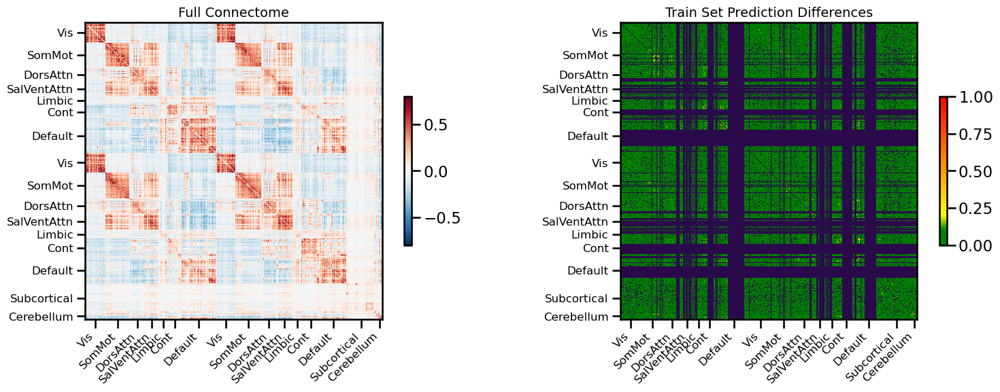

<Figure size 640x480 with 0 Axes>

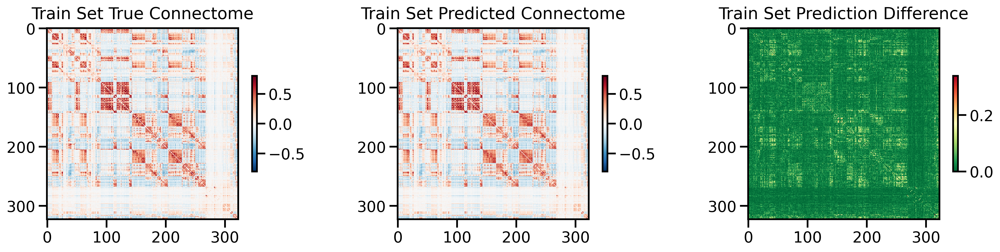

<Figure size 640x480 with 0 Axes>

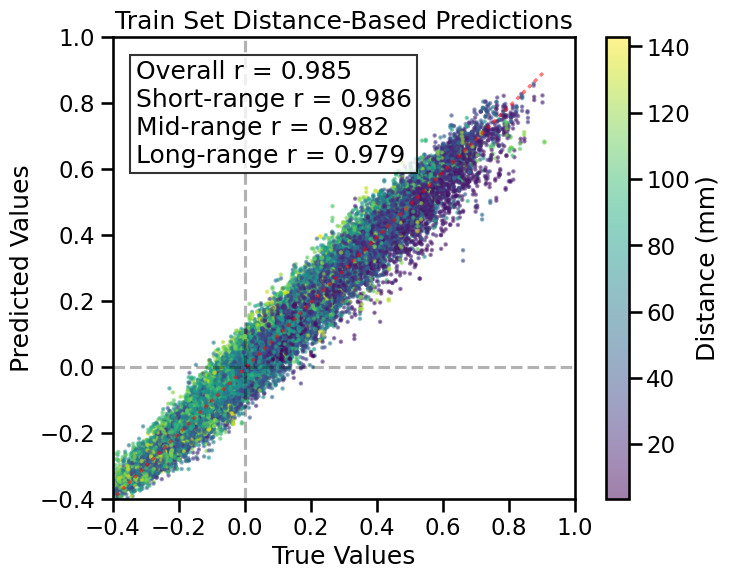

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 132 regions, 17292 connections


<Figure size 640x480 with 0 Axes>

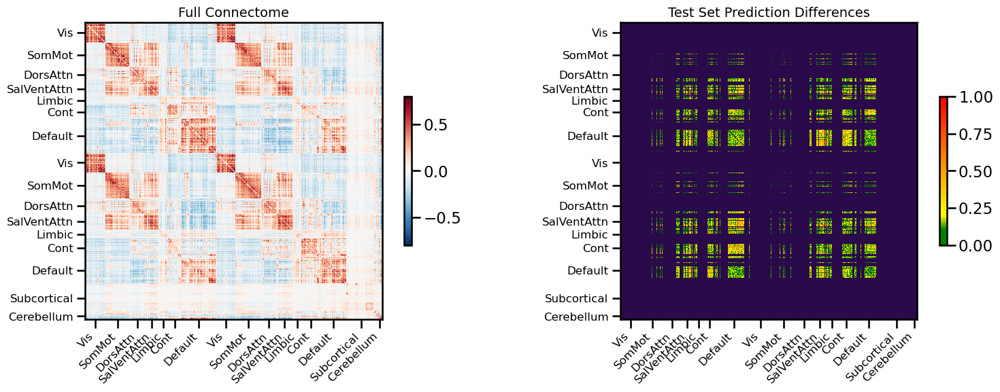

<Figure size 640x480 with 0 Axes>

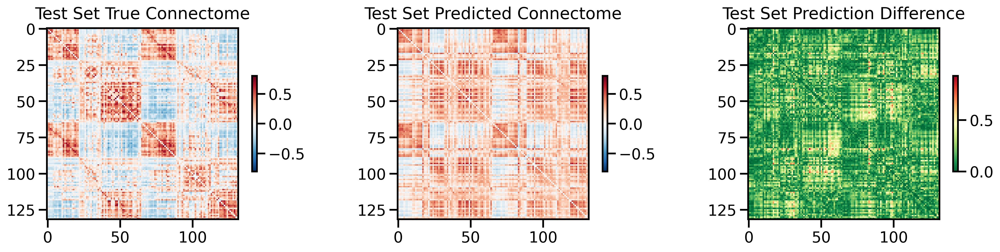

<Figure size 640x480 with 0 Axes>

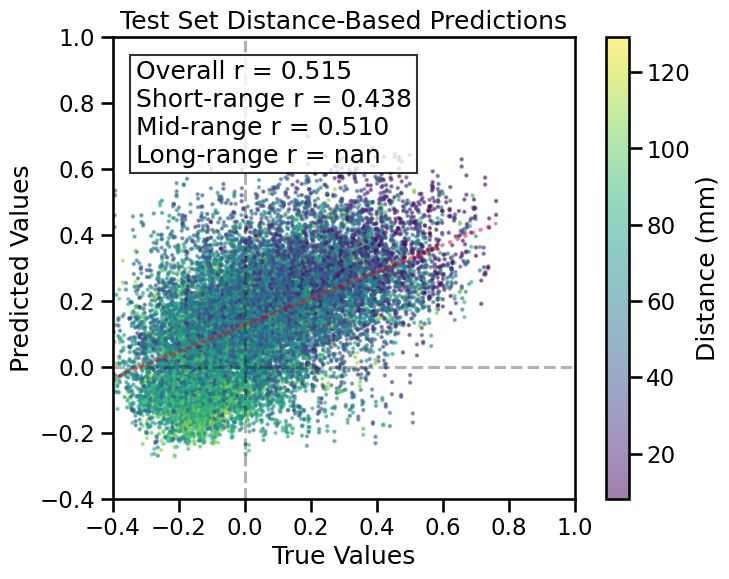

TRAIN METRICS
GLOBAL: mse=0.001093, mae=0.023344, r2=0.9684, pearson_r=0.9845, spearman_r=0.9789, geodesic_distance=14.1583
DISTANCE-BASED: short=0.9863, mid=0.9824, long=0.9785
HEMISPHERIC: left=0.9835, right=0.9867, inter=0.9860
CONNECTION STRENGTH: neg=0.6592, weak=0.9716, pos=0.8852
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9767    0.9820
  Default       0.9809    0.9822
  SalVentAttn    0.9792    0.9825
  Limbic        0.9913    0.9848
  DorsAttn      0.9801    0.9834
  SomMot        0.9871    0.9820
  Vis           0.9793    0.9846
  Subcortical    0.9951    0.9832
  Cerebellum    0.9957    0.9848

TEST METRICS
GLOBAL: mse=0.045148, mae=0.168314, r2=0.0036, pearson_r=0.5148, spearman_r=0.5236, geodesic_distance=12.2379
DISTANCE-BASED: short=0.4376, mid=0.5101
HEMISPHERIC: left=0.5158, right=0.5704, inter=0.5022
CONNECTION STRENGTH: neg=-0.0500, weak=0.4306, pos=0.1922
NETWORK CORRELATIONS:
  NETWORK      INTRA      IN


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




best_val_loss,▁
test_mse_loss,▆█▅▃▃▆▃▂▂▅▂▂▇▄▄▁▃▃▃▃▇▇▆▅█▆▄▅▄▇▂▅▄▄▇▄▆▅▄▅
train_mse_loss,█▅▄▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0.02558
test_mse_loss,0.04504
train_mse_loss,0.0029


Final evaluation metrics logged successfully.



unclosed <socket.socket fd=112, family=2, type=1, proto=0, laddr=('127.0.0.1', 41486), raddr=('127.0.0.1', 46297)>



unclosed <socket.socket fd=114, family=2, type=1, proto=0, laddr=('127.0.0.1', 59706), raddr=('127.0.0.1', 44281)>


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: j3tu1ykc
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/j3tu1ykc
Initialized sweep with ID: j3tu1ykc
Testing network: Subcortex
Temporal
Occipital
Parietal
Frontal


wandb: Agent Starting Run: pmep3ffd with config:
wandb: 	aug_prob: 0.2
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 128
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.2
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 70
wandb: 	input_dim: 14760
wandb: 	learning_rate: 0.0001
wandb: 	nhead: 4
wandb: 	num_layers: 4
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 60
wandb: 	transformer_dropout: 0.1
wandb: 	use_alibi: False
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-j3tu1ykc/config-pmep3ffd.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored wa

Processing inner fold 0



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in SMT model: 1399947
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.16 GB
Best val loss so far at epoch 1: 0.0515
Best val loss so far at epoch 2: 0.0414
Best val loss so far at epoch 3: 0.0386
Best val loss so far at epoch 4: 0.0381
Best val loss so far at epoch 5: 0.0295
Epoch 5/70, Train Loss: 0.0773, Val Loss: 0.0295, Time: 2.47s
Best val loss so far at epoch 8: 0.0259
Best val loss so far at epoch 9: 0.0238
Epoch 10/70, Train Loss: 0.0413, Val Loss: 0.0259, Time: 2.42s
Best val loss so far at epoch 12: 0.0231
Best val loss so far at epoch 13: 0.0223
Best val loss so far at epoch 14: 0.0221
Epoch 15/70, Train Loss: 0.0256, Val Loss: 0.0231, Time: 2.43s
Best val loss so far at epoch 17: 0.0220
Best val loss so far at epoch 18: 0.0207
Epoch 20/70, Train Loss: 0.0178, Val Loss: 0.0226, Time: 2.40s
Epoch 25/70, Train Loss: 0.0135, Val Loss: 0.0229, Time: 2.37s
Epoch 30/70, Train Loss: 0.0161, V


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇████
fold0_train_loss,█▅▄▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▆▅▅▂▁▁▁▁▁▁▃▂▁▄▁▁▁▁▂▂▁▃▁▁▂▂▂▂▂▂▂▂▁▂▂▂▂▂▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,62
fold0_train_loss,0.00498
fold0_val_loss,0.02436


wandb: Agent Starting Run: 2j58lr6z with config:
wandb: 	aug_prob: 0.3
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 64
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.1
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 90
wandb: 	input_dim: 14760
wandb: 	learning_rate: 0.0001
wandb: 	nhead: 4
wandb: 	num_layers: 2
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 20
wandb: 	transformer_dropout: 0.2
wandb: 	use_alibi: True
wandb: 	weight_decay: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-j3tu1ykc/config-2j58lr6z.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored wandb

Processing inner fold 0



unclosed <socket.socket fd=112, family=2, type=1, proto=0, laddr=('127.0.0.1', 58726), raddr=('127.0.0.1', 41175)>



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in SMT model: 2016971
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.16 GB
Best val loss so far at epoch 1: 0.0422
Best val loss so far at epoch 3: 0.0290
Best val loss so far at epoch 4: 0.0281
Epoch 5/90, Train Loss: 0.0635, Val Loss: 0.0291, Time: 2.83s
Best val loss so far at epoch 7: 0.0275
Best val loss so far at epoch 10: 0.0274
Epoch 10/90, Train Loss: 0.0444, Val Loss: 0.0274, Time: 2.90s
Best val loss so far at epoch 14: 0.0269
Epoch 15/90, Train Loss: 0.0413, Val Loss: 0.0276, Time: 3.06s
Epoch 20/90, Train Loss: 0.0277, Val Loss: 0.0270, Time: 7.08s
Best val loss so far at epoch 21: 0.0265
Best val loss so far at epoch 22: 0.0259
Best val loss so far at epoch 24: 0.0256
Epoch 25/90, Train Loss: 0.0223, Val Loss: 0.0261, Time: 2.73s
Epoch 30/90, Train Loss: 0.0186, Val Loss: 0.0275, Time: 2.73s
Epoch 35/90, Train Loss: 0.0211, Val Loss: 0.0271, Time: 2.77s
Best val loss so far at epoc


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇████
fold0_train_loss,█▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▂▂▂▂▂▂▂▂▁▁▂▂▂▁▂▁▁▂▂▁▃▅▃▅█▃▃▄▄▅▃▃▃▄▅▅▅▇▆█
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,89
fold0_train_loss,0.00388
fold0_val_loss,0.04479


wandb: Agent Starting Run: yox9gtnk with config:
wandb: 	aug_prob: 0.3
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 128
wandb: 	deep_hidden_dims: [512, 256, 128]
wandb: 	dropout_rate: 0.1
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 90
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	nhead: 4
wandb: 	num_layers: 2
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 60
wandb: 	transformer_dropout: 0.1
wandb: 	use_alibi: False
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-j3tu1ykc/config-yox9gtnk.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignore


unclosed <socket.socket fd=114, family=2, type=1, proto=0, laddr=('127.0.0.1', 51646), raddr=('127.0.0.1', 37601)>




Processing inner fold 0



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in SMT model: 1798795
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.16 GB
Best val loss so far at epoch 1: 0.0472
Best val loss so far at epoch 2: 0.0413
Best val loss so far at epoch 3: 0.0377
Best val loss so far at epoch 4: 0.0349
Best val loss so far at epoch 5: 0.0314
Epoch 5/90, Train Loss: 0.0683, Val Loss: 0.0314, Time: 2.30s
Best val loss so far at epoch 7: 0.0276
Best val loss so far at epoch 9: 0.0259
Epoch 10/90, Train Loss: 0.0391, Val Loss: 0.0289, Time: 2.36s
Epoch 15/90, Train Loss: 0.0336, Val Loss: 0.0281, Time: 2.34s
Best val loss so far at epoch 17: 0.0245
Best val loss so far at epoch 18: 0.0226
Epoch 20/90, Train Loss: 0.0197, Val Loss: 0.0239, Time: 6.80s
Epoch 25/90, Train Loss: 0.0254, Val Loss: 0.0226, Time: 2.30s
Best val loss so far at epoch 26: 0.0225
Best val loss so far at epoch 29: 0.0215
Epoch 30/90, Train Loss: 0.0221, Val Loss: 0.0247, Time: 2.30s
Best val los


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇██
fold0_train_loss,██▇▆▆▄▅▄▄▄▃▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▂▂▂▂▁▂▁▁▁▁▁▁
fold0_val_loss,█▆▇▅▇▅▄▅▄▄▃▃▃▂▂▂▂▃▁▃▂▁▂▁▁▂▂▁▁▂▂▂▂▂▂▂▁▁▂▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,87
fold0_train_loss,0.00315
fold0_val_loss,0.0196


wandb: Agent Starting Run: cssmsrl3 with config:
wandb: 	aug_prob: 0.5
wandb: 	batch_size: 1024
wandb: 	binarize: False
wandb: 	d_model: 128
wandb: 	deep_hidden_dims: [512, 256, 128]
wandb: 	dropout_rate: 0.2
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 70
wandb: 	input_dim: 14760
wandb: 	learning_rate: 9e-05
wandb: 	nhead: 4
wandb: 	num_layers: 2
wandb: 	num_workers: 2
wandb: 	prefetch_factor: 4
wandb: 	token_encoder_dim: 60
wandb: 	transformer_dropout: 0.2
wandb: 	use_alibi: True
wandb: 	weight_decay: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.

unclosed file <_io.TextIOWrapper name='/scratch/asr655/neuroinformatics/GeneEx2Conn/wandb/sweep-j3tu1ykc/config-cssmsrl3.yaml' mode='r' encoding='utf-8'>



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.


wandb: WARNING Ignored 


unclosed <socket.socket fd=112, family=2, type=1, proto=0, laddr=('127.0.0.1', 34562), raddr=('127.0.0.1', 46067)>




Processing inner fold 0



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in SMT model: 1798795
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.16 GB
Best val loss so far at epoch 1: 0.0574
Best val loss so far at epoch 3: 0.0430
Best val loss so far at epoch 4: 0.0390
Best val loss so far at epoch 5: 0.0372
Epoch 5/70, Train Loss: 0.1152, Val Loss: 0.0372, Time: 2.54s
Best val loss so far at epoch 6: 0.0360
Best val loss so far at epoch 7: 0.0334
Best val loss so far at epoch 8: 0.0316
Best val loss so far at epoch 9: 0.0290
Best val loss so far at epoch 10: 0.0277
Epoch 10/70, Train Loss: 0.0677, Val Loss: 0.0277, Time: 2.54s
Best val loss so far at epoch 11: 0.0263
Best val loss so far at epoch 12: 0.0259
Best val loss so far at epoch 13: 0.0259
Epoch 15/70, Train Loss: 0.0515, Val Loss: 0.0279, Time: 2.46s
Best val loss so far at epoch 18: 0.0259
Epoch 20/70, Train Loss: 0.0394, Val Loss: 0.0278, Time: 2.39s
Best val loss so far at epoch 21: 0.0258
Epoch 25/70, Tra


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇███
fold0_train_loss,█▅▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▇█▄▄▃▂▂▂▂▂▃▂▂▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_train_pearson,▁
mean_val_loss,▁
mean_val_pearson,▁
fold0_epoch,69
fold0_train_loss,0.00607
fold0_val_loss,0.02069


wandb: Sorting runs by +summary_metrics.mean_val_loss

The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.


Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


BEST CONFIG {'nhead': 4, 'epochs': 90, 'd_model': 128, 'aug_prob': 0.3, 'binarize': False, 'input_dim': 14760, 'use_alibi': False, 'batch_size': 1024, 'num_layers': 2, 'num_workers': 2, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'learning_rate': 9e-05, 'prefetch_factor': 4, 'deep_hidden_dims': [512, 256, 128], 'token_encoder_dim': 60, 'encoder_output_dim': 10, 'transformer_dropout': 0.1}
Number of learnable parameters in SMT model: 1798795



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.



Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.16 GB
Best val loss so far at epoch 1: 0.1218
Epoch 5/90, Train Loss: 0.0575, Val Loss: 0.1874, Time: 3.69s
Epoch 10/90, Train Loss: 0.0298, Val Loss: 0.7233, Time: 3.76s



unclosed <socket.socket fd=83, family=2, type=1, proto=0, laddr=('127.0.0.1', 41338), raddr=('127.0.0.1', 34029)>



unclosed <socket.socket fd=82, family=2, type=1, proto=0, laddr=('127.0.0.1', 54186), raddr=('127.0.0.1', 46455)>



unclosed <socket.socket fd=83, family=2, type=1, proto=0, laddr=('127.0.0.1', 41338), raddr=('127.0.0.1', 34029)>



unclosed <socket.socket fd=82, family=2, type=1, proto=0, laddr=('127.0.0.1', 54186), raddr=('127.0.0.1', 46455)>




Epoch 15/90, Train Loss: 0.0245, Val Loss: 0.5097, Time: 3.64s
Epoch 20/90, Train Loss: 0.0181, Val Loss: 0.4854, Time: 3.68s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.724345
Epoch 25/90, Train Loss: 0.0148, Val Loss: 0.5617, Time: 5.96s
Epoch 30/90, Train Loss: 0.0174, Val Loss: 0.5849, Time: 3.62s
Epoch 35/90, Train Loss: 0.0153, Val Loss: 1.2649, Time: 3.64s
Epoch 40/90, Train Loss: 0.0141, Val Loss: 1.1375, Time: 3.67s

LR REDUCED: 0.000027 → 0.000008 at Val Loss: 1.720974
Epoch 45/90, Train Loss: 0.0130, Val Loss: 1.6384, Time: 3.87s

Early stopping triggered at epoch 46. Restoring best model with Val Loss: 0.1218, Pearson Correlation: -0.0180
Running train evaluation...

=== TRAIN EVALUATION ===
Evaluating 400 regions, 159600 connections


<Figure size 640x480 with 0 Axes>

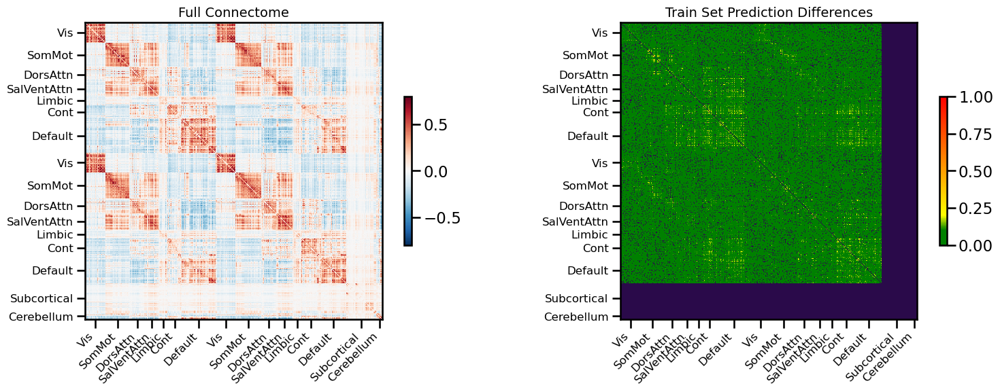

<Figure size 640x480 with 0 Axes>

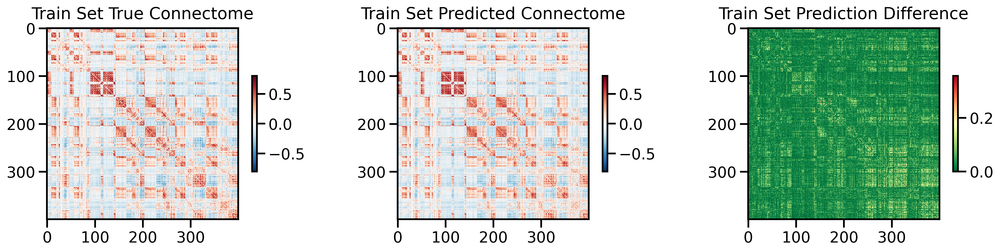

<Figure size 640x480 with 0 Axes>

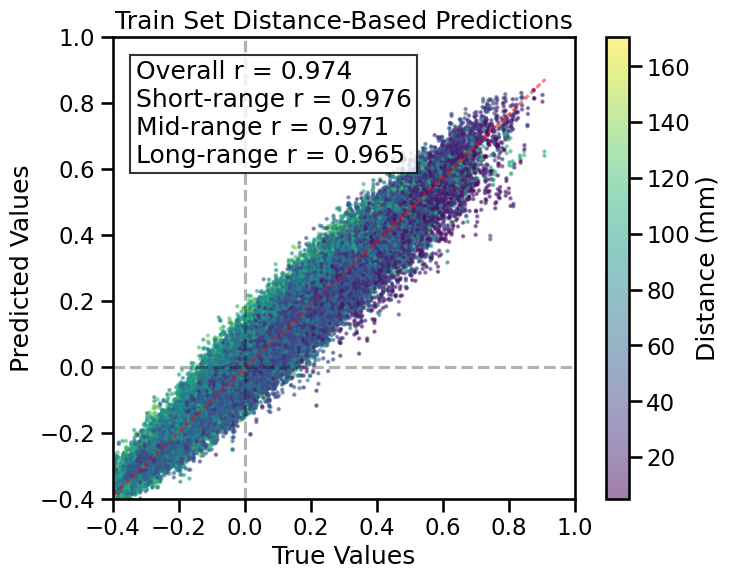

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 55 regions, 2970 connections


<Figure size 640x480 with 0 Axes>

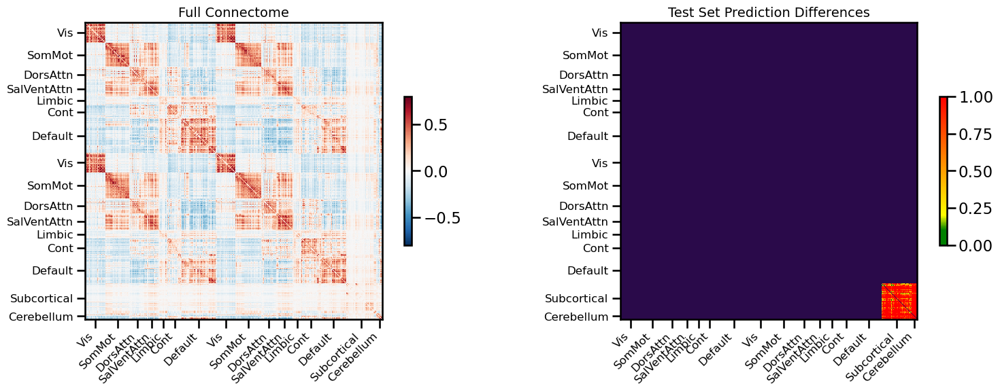

<Figure size 640x480 with 0 Axes>

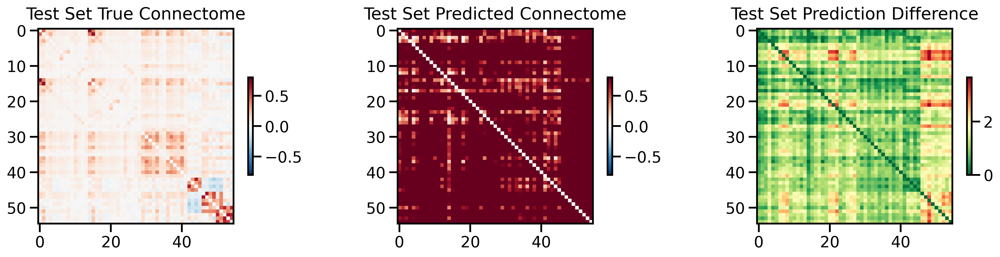

<Figure size 640x480 with 0 Axes>

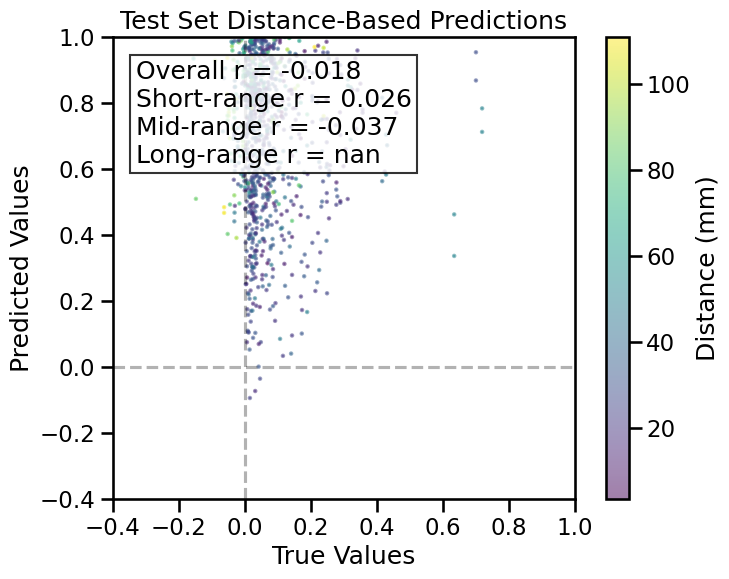

TRAIN METRICS
GLOBAL: mse=0.002116, mae=0.033804, r2=0.9475, pearson_r=0.9738, spearman_r=0.9718, geodesic_distance=13.4261
DISTANCE-BASED: short=0.9760, mid=0.9707, long=0.9655
HEMISPHERIC: left=0.9758, right=0.9790, inter=0.9761
CONNECTION STRENGTH: neg=0.6487, weak=0.9544, pos=0.8166
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9778    0.9772
  Default       0.9745    0.9764
  SalVentAttn    0.9839    0.9797
  Limbic        0.9769    0.9806
  DorsAttn      0.9789    0.9775
  SomMot        0.9723    0.9742
  Vis           0.9760    0.9774

TEST METRICS
GLOBAL: mse=1.899900, mae=1.242468, r2=-210.3028, pearson_r=-0.0180, spearman_r=-0.1097, geodesic_distance=19.1188
DISTANCE-BASED: short=0.0263, mid=-0.0370
HEMISPHERIC: left=0.0831, right=-0.0679, inter=-0.1971
CONNECTION STRENGTH: weak=-0.1263
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Subcortical   -0.2225   -0.1430
  Cerebellum


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




best_val_loss,▁
test_mse_loss,▁▁▃▁▁▂▃▃▄▃▃▃▃▃▂▁▄▃▄▄▃▃▃▃▄▃▃▃▃▅▆▅▄▆▅▇▇███
train_mse_loss,█▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0.0196
test_mse_loss,1.90097
train_mse_loss,0.01049


Final evaluation metrics logged successfully.



unclosed <socket.socket fd=83, family=2, type=1, proto=0, laddr=('127.0.0.1', 41338), raddr=('127.0.0.1', 34029)>



unclosed <socket.socket fd=82, family=2, type=1, proto=0, laddr=('127.0.0.1', 54186), raddr=('127.0.0.1', 46455)>




CPU Usage: 9.2%
RAM Usage: 4.8%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 5805.74 seconds (96.76 minutes)


6713

<Figure size 640x480 with 0 Axes>

In [11]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='lobe',
              random_seed=42,
              search_method=('wandb', 'mse', 4),
              track_wandb=True,
              skip_cv=False,
              model_type='shared_transformer',
              use_gpu=True, 
              null_model='none',
              use_folds=[0, 1, 2, 3, 4]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
Lobe coverage: 100.0% of regions
Lobe sizes: {'Temporal': 91, 'Occipital': 52, 'Parietal': 125, 'Frontal': 132, 'Subcortex': 46, 'Cerebellum': 9}
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset



distutils Version classes are deprecated. Use packaging.version instead.


ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: m3xt710m
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/m3xt710m
Initialized sweep with ID: m3xt710m
Testing network: Frontal
Temporal
Occipital
Parietal
Subcortex
Cerebellum
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.3, 'epochs': 90, 'num_workers': 2, 'prefetch_factor': 4}



The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.




Number of learnable parameters in SMT w/ CLS model: 4686987



The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.



Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display





Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.02 GB



TensorFloat32 tensor cores for float32 matrix multiplication available but not enabled. Consider setting `torch.set_float32_matmul_precision('high')` for better performance.




Best val loss so far at epoch 1: 0.0532
Best val loss so far at epoch 2: 0.0526
Best val loss so far at epoch 4: 0.0514
Best val loss so far at epoch 5: 0.0500
Epoch 5/90, Train Loss: 0.0751, Val Loss: 0.0500, Time: 7.08s
Best val loss so far at epoch 8: 0.0474
Epoch 10/90, Train Loss: 0.0442, Val Loss: 0.0528, Time: 7.52s
Epoch 15/90, Train Loss: 0.0303, Val Loss: 0.0655, Time: 6.87s
Epoch 20/90, Train Loss: 0.0246, Val Loss: 0.0568, Time: 6.92s
Epoch 25/90, Train Loss: 0.0206, Val Loss: 0.0535, Time: 6.86s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.058636
Epoch 30/90, Train Loss: 0.0165, Val Loss: 0.0592, Time: 6.78s
Epoch 35/90, Train Loss: 0.0174, Val Loss: 0.0656, Time: 7.40s
Epoch 40/90, Train Loss: 0.0195, Val Loss: 0.0624, Time: 6.91s
Epoch 45/90, Train Loss: 0.0148, Val Loss: 0.0683, Time: 6.76s
Epoch 50/90, Train Loss: 0.0112, Val Loss: 0.0574, Time: 6.66s

LR REDUCED: 0.000027 → 0.000008 at Val Loss: 0.057554

Early stopping triggered at epoch 53. Restoring best model w

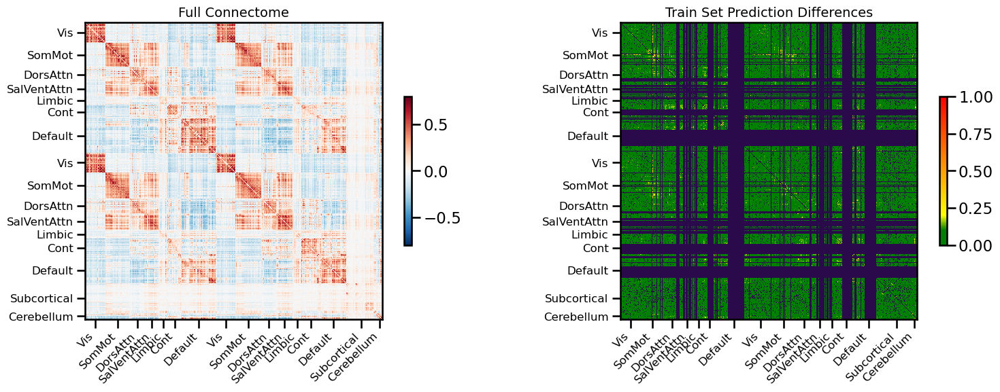

<Figure size 640x480 with 0 Axes>

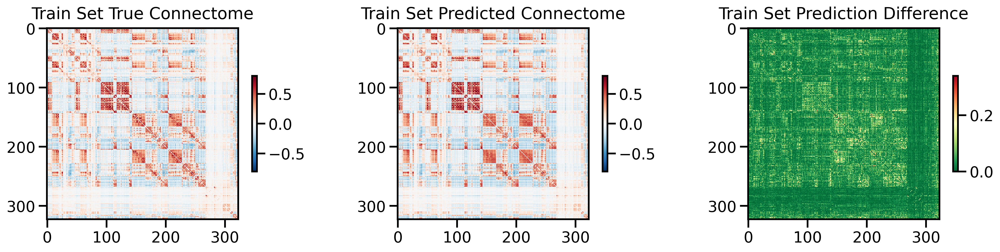

<Figure size 640x480 with 0 Axes>

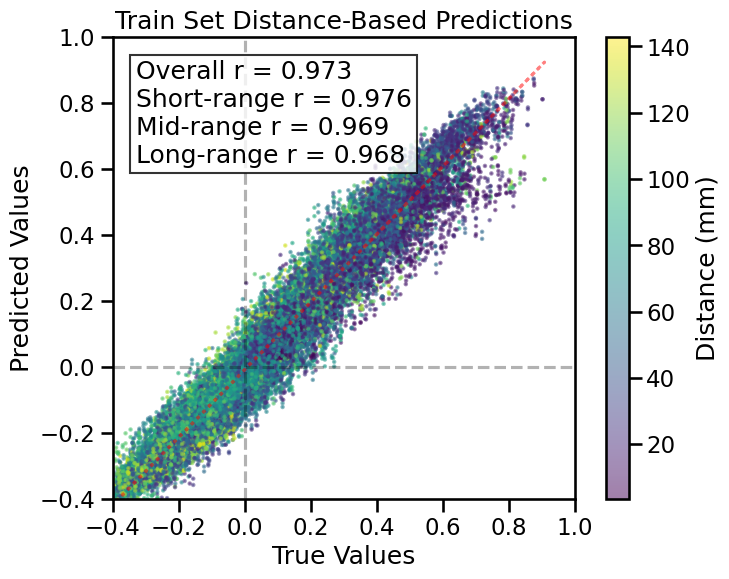

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 132 regions, 17292 connections


<Figure size 640x480 with 0 Axes>

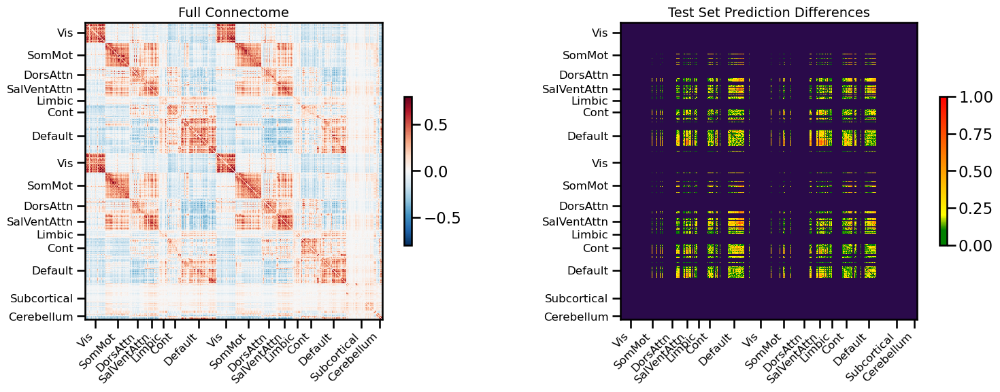

<Figure size 640x480 with 0 Axes>

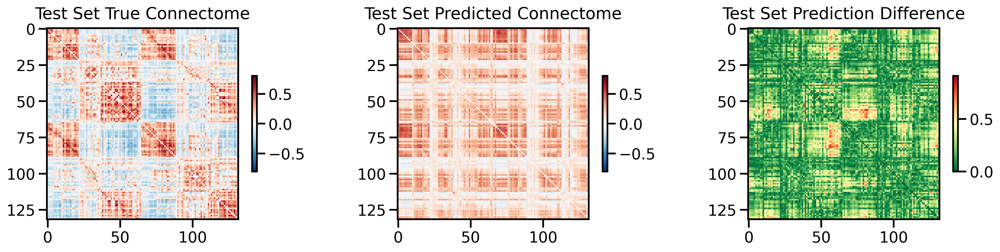

<Figure size 640x480 with 0 Axes>

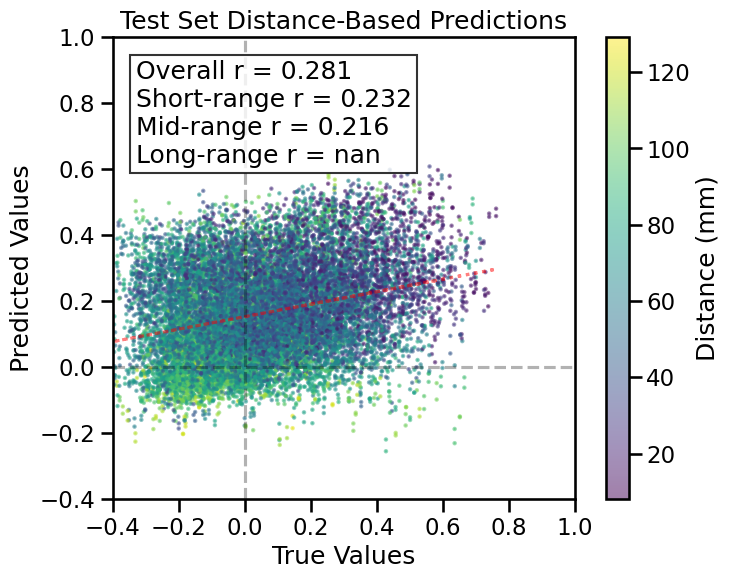

TRAIN METRICS
GLOBAL: mse=0.002110, mae=0.033244, r2=0.9391, pearson_r=0.9731, spearman_r=0.9645, geodesic_distance=15.0166
DISTANCE-BASED: short=0.9755, mid=0.9686, long=0.9685
HEMISPHERIC: left=0.9720, right=0.9753, inter=0.9749
CONNECTION STRENGTH: neg=0.5682, weak=0.9505, pos=0.8095
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9713    0.9721
  Default       0.9669    0.9729
  SalVentAttn    0.9690    0.9736
  Limbic        0.9863    0.9767
  DorsAttn      0.9714    0.9731
  SomMot        0.9785    0.9712
  Vis           0.9648    0.9736
  Subcortical    0.9904    0.9720
  Cerebellum    0.9880    0.9738

TEST METRICS
GLOBAL: mse=0.059689, mae=0.193324, r2=-0.3173, pearson_r=0.2813, spearman_r=0.2645, geodesic_distance=14.0439
DISTANCE-BASED: short=0.2316, mid=0.2158
HEMISPHERIC: left=0.1783, right=0.3000, inter=0.2763
CONNECTION STRENGTH: neg=-0.0298, weak=0.2032, pos=0.1126
NETWORK CORRELATIONS:
  NETWORK      INTRA      I


Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display




best_val_loss,▁
test_mse_loss,▃▃▂▂▂▁▂▃▄▃▇▇▄▄▇▇▃▅▅▃▅▅▅▇▆▆▇▆▆▄▅▇▆▇█▅▆▆▄▅
train_mse_loss,█▆▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▁▁▂▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.05959
train_mse_loss,0.01186


Final evaluation metrics logged successfully.
CPU Usage: 4.1%
RAM Usage: 15.4%
Available RAM: 1.2T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  2% |
Sim complete
Simulation completed in 470.02 seconds (7.83 minutes)


12674

<Figure size 640x480 with 0 Axes>

In [11]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='lobe',
              random_seed=42,
              search_method=('wandb', 'mse', 4),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer_cls',
              use_gpu=True, 
              null_model='none',
              use_folds=[3]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()